# QBUS6810 Group Assignment 


## Import Packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

import warnings
warnings.filterwarnings('ignore') 

# Plot settings (from tutorial4)
sns.set_context('notebook') # optimises figures for notebook display
sns.set_style('ticks') # set default plot style
colours = ['#4E79A7','#F28E2C','#E15759','#76B7B2','#59A14F', 
          '#EDC949','#AF7AA1','#FF9DA7','#9C755F','#BAB0AB']
sns.set_palette(colours) # set custom color scheme

%matplotlib inline
plt.rcParams['figure.figsize'] = (9, 6)
plt.rcParams['figure.dpi'] = 80
%config InlineBackend.figure_format = 'retina'

#display all the columns and rows 
#https://builtin.com/data-science/pandas-show-all-columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

## Import Dataset

In [2]:
data = pd.read_csv("listings.csv")

## Data Processing 

### General Infomation

In [3]:
data.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11156,https://www.airbnb.com/rooms/11156,20221210142942,2022-12-10,city scrape,An Oasis in the City,Very central to the city which can be reached ...,"It is very close to everything and everywhere,...",https://a0.muscache.com/pictures/2797669/17895...,40855,https://www.airbnb.com/users/show/40855,Colleen,2009-09-23,"Potts Point, Australia","Recently retired, I've lived & worked on 4 con...",within an hour,100%,100%,f,https://a0.muscache.com/im/users/40855/profile...,https://a0.muscache.com/im/users/40855/profile...,Potts Point,1.0,1.0,"['email', 'phone']",t,f,"Potts Point, New South Wales, Australia",Sydney,NaN,-33.86767,151.22497,Private room in rental unit,Private room,1,NaN,1 shared bath,1.0,1.0,"[""Hair dryer"", ""Refrigerator"", ""Bed linens"", ""...",$65.00,90,180,90,90,180,180,90.0,180.0,NaN,t,29,59,89,364,2022-12-10,195,0,0,2009-12-05,2020-03-13,4.59,4.76,4.30,4.80,4.76,4.82,4.71,NaN,f,1,0,1,0,1.23
1,14250,https://www.airbnb.com/rooms/14250,20221210142942,2022-12-10,city scrape,Manly Harbour House,"Beautifully renovated, spacious and quiet, our...",Balgowlah Heights is one of the most prestigio...,https://a0.muscache.com/pictures/56935671/fdb8...,55948,https://www.airbnb.com/users/show/55948,Heidi,2009-11-20,"Sydney, Australia",I am a Canadian who has made Australia her hom...,within a few hours,100%,84%,f,https://a0.muscache.com/im/users/55948/profile...,https://a0.muscache.com/im/users/55948/profile...,Balgowlah,2.0,2.0,"['email', 'phone']",t,t,"Balgowlah, New South Wales, Australia",Manly,NaN,-33.80084,151.26378,Entire home,Entire home/apt,6,NaN,3 baths,3.0,3.0,"[""Hair dryer"", ""Dryer"", ""Refrigerator"", ""Firep...",$470.00,2,22,2,2,22,22,2.0,22.0,NaN,t,0,0,0,0,2022-12-10,3,0,0,2016-01-02,2021-06-01,4.67,4.33,4.33,4.67,4.33,4.67,4.33,Exempt,f,2,2,0,0,0.04
2,15253,https://www.airbnb.com/rooms/15253,20221210142942,2022-12-10,city scrape,Unique Designer Rooftop Apartment in City Loca...,You will be staying in a unique duplex apartme...,The location is really central and there is nu...,https://a0.muscache.com/pictures/miso/Hosting-...,59850,https://www.airbnb.com/users/show/59850,Morag,2009-12-03,"Sydney, Australia",I am originally Scottish but I have made Sydne...,within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/730ee...,https://a0.muscache.com/im/pictures/user/730ee...,Darlinghurst,2.0,6.0,"['email', 'phone']",t,t,"Darlinghurst, New South Wales, Australia",Sydney,NaN,-33.87964,151.21680,Private room in condo,Private room,2,NaN,1 private bath,1.0,1.0,"[""Hair dryer"", ""Dining table"", ""Board games"", ...",$102.00,1,90,1,1,1125,1125,1.0,1125.0,NaN,t,2,15,24,277,2022-12-10,457,73,8,2012-02-23,202

In [4]:
data.shape

(22100, 75)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22100 entries, 0 to 22099
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            22100 non-null  int64  
 1   listing_url                                   22100 non-null  object 
 2   scrape_id                                     22100 non-null  int64  
 3   last_scraped                                  22100 non-null  object 
 4   source                                        22100 non-null  object 
 5   name                                          22093 non-null  object 
 6   description                                   21460 non-null  object 
 7   neighborhood_overview                         12727 non-null  object 
 8   picture_url                                   22100 non-null  object 
 9   host_id                                       22100 non-null 

In [6]:
!pip install dabl

In [7]:
from dabl import detect_types
data_types = detect_types(data)
data_types

,continuous,dirty_float,low_card_int_ordinal,low_card_int_categorical,categorical,date,free_string,useless
id,True,False,False,False,False,False,False,False
listing_url,False,False,False,False,False,False,True,False
scrape_id,False,False,False,False,False,False,False,True
last_scraped,False,False,False,False,True,False,False,False
source,False,False,False,False,True,False,False,False
name,False,False,False,False,False,False,True,False
description,False,False,False,False,False,False,True,False
neighborhood_overview,False,False,False,False,False,False,True,False
picture_url,False,False,False,False,False,False,True,False
host_id,True,False,False,False,False,False,False,False


In [8]:
data_types[data_types['useless'] == True]

,continuous,dirty_float,low_card_int_ordinal,low_card_int_categorical,categorical,date,free_string,useless
scrape_id,False,False,False,False,False,False,False,True
host_has_profile_pic,False,False,False,False,False,False,False,True
neighbourhood_group_cleansed,False,False,False,False,False,False,False,True
bathrooms,False,False,False,False,False,False,False,True
calendar_updated,False,False,False,False,False,False,False,True
has_availability,False,False,False,False,False,False,False,True
calculated_host_listings_count_shared_rooms,False,False,False,False,False,False,False,True


In [9]:
data['host_has_profile_pic'].value_counts()
#FIgure out if the useless function is accurate.
#The deviation between t & f is huge which is necessary to drop it.

t    21930
f      168
Name: host_has_profile_pic, dtype: int64

In [10]:
data['neighbourhood_group_cleansed'].value_counts()

Series([], Name: neighbourhood_group_cleansed, dtype: int64)

In [11]:
data['bathrooms'].value_counts()

Series([], Name: bathrooms, dtype: int64)

In [12]:
data['calendar_updated'].value_counts()

Series([], Name: calendar_updated, dtype: int64)

### Drop Irrelevant variables

In [13]:
#drop irrelevant variables eg. id, urls ... also since there are few missing values in "name", we can not explore the importance of naming 
drop_variables = ['id','name','listing_url','scrape_id','last_scraped','picture_url', 'host_id','host_url', 'host_name','host_thumbnail_url', 'host_picture_url','calendar_updated','neighbourhood_group_cleansed','bathrooms','host_has_profile_pic','neighbourhood']
data = data.drop(drop_variables, axis = 1)

##drop proved useless predictor
#neighborhood column share the same value withn 'neigihborhood_cleansed'

### Converting data type

### Date 

In [14]:
#convert host_since to the number of days from the registered day to today(the end of 2022)
#from datetime import timedelta
from datetime import datetime

data['host_since'] = pd.to_datetime(data['host_since'], format = '%Y/%m/%d') #convert to format of yyyy-mm-dd

data['end_2022'] = '2022-12-31' #insert today's date
data['end_2022'] = pd.to_datetime(data['end_2022'], format = '%Y/%m/%d')

# difference between dates in days
data['host_since'] = (data['end_2022'] - data['host_since']).dt.days 
#https://stackoverflow.com/questions/44980774/attributeerror-series-object-has-no-attribute-days

data['host_since'] = data['host_since'].astype(float)


In [15]:
data['calendar_last_scraped'] = pd.to_datetime(data['calendar_last_scraped'])
data['first_review'] = pd.to_datetime(data['first_review'])
data['last_review'] = pd.to_datetime(data['last_review'])
data['review_time_gap'] =(data['last_review'] - data['first_review'])
data['review_time_gap'] = data['review_time_gap'].dt.days
data = data.drop(['last_review','first_review'],axis=1)

##### Removing sign

In [16]:
#remove % sign from the rate
data['host_response_rate'] = data['host_response_rate'].str.replace('%','')
data['host_response_rate'] = pd.to_numeric(data['host_response_rate'])

In [17]:
data['host_acceptance_rate'] = data['host_acceptance_rate'].str.replace('%','')
data['host_acceptance_rate'] = pd.to_numeric(data['host_acceptance_rate'])

In [18]:
#remove $ sign from price to make sure the price is numerical data
data['price'] = pd.to_numeric(data['price'].apply(lambda x : str(x).replace('$','').replace(",",'')),errors='coerce')
#https://github.com/mrat1618/airbnb-eda-sydney/blob/master/airbnb-eda-sydney.ipynb

In [19]:
#replace the br in description
data['description'] = data['description'].str.replace(r'\b(br|b)\b', '', regex=True)

### Removing text behind numbers

In [20]:
data['bathrooms_text'] = data['bathrooms_text'].astype(str)

In [21]:
def extract_bathroom_info(text):
    if 'Private' in text or 'private' in text:
        bathroom_type = 1
    elif 'shared' in text or 'Shared' in text:
        bathroom_type = 2
    else:
        bathroom_type = 0

    # Extract the bathroom number
    try:
        bathroom_number = float(text.split()[0])
    except:
        bathroom_number = 0.5

    return bathroom_number, bathroom_type

# Extract bathroom number and type from 'bathrooms_text' column
data[['bathroom_number', 'bathroom_type']] = data['bathrooms_text'].apply(extract_bathroom_info).apply(pd.Series)

# Print the resulting dataframe
print(data[['bathrooms_text', 'bathroom_number', 'bathroom_type']])


          bathrooms_text  bathroom_number  bathroom_type
0          1 shared bath              1.0            2.0
1                3 baths              3.0            0.0
2         1 private bath              1.0            1.0
3              1.5 baths              1.5            0.0
4          1 shared bath              1.0            2.0
5                2 baths              2.0            0.0
6                 1 bath              1.0            0.0
7                 1 bath              1.0            0.0
8          1 shared bath              1.0            2.0
9                 1 bath              1.0            0.0
10         1 shared bath              1.0            2.0
11                1 bath              1.0            0.0
12                1 bath              1.0            0.0
13                1 bath              1.0            0.0
14                1 bath              1.0            0.0
15                   nan              NaN            0.0
16                1 bath       

In [22]:
# remove cleansed bathroom list before 'bedroom'
data = data.drop(['bathroom_number', 'bathroom_type'], axis=1)

# Get the location of original data
column_index = data.columns.get_loc('bathrooms_text')

# Insert it after 'bathrooms_text'
data.insert(column_index + 1, 'bathroom_number', data['bathrooms_text'].apply(extract_bathroom_info).apply(lambda x: x[0]))
data.insert(column_index + 2, 'bathroom_type', data['bathrooms_text'].apply(extract_bathroom_info).apply(lambda x: x[1]))


### Replace with 0 and 1 

In [23]:
data["host_is_superhost"].replace({'f': 0, 't': 1}, inplace=True)

In [24]:
data['host_identity_verified'].replace({'f': 0, 't': 1}, inplace=True)

In [25]:
data.loc[(data['license'] != 0) & (data['license'].notnull()),'license'] = 1
data.loc[data['license'] == 0,'license'] = 0

In [26]:
data['instant_bookable'].replace({'f': 0, 't': 1}, inplace=True)

In [27]:
data['has_availability'].replace({'f': 0, 't': 1}, inplace=True)

In [28]:
#to extract the host location within AU
import re

host_location = []
for location in data['host_location'].astype(str):
    AU = re.findall(r'(Australia|AU|NSW|Sydney|New South Wales)', location)
    host_loc_in_AU = len(AU) != 0
    host_location.append(int(host_loc_in_AU))

data['host_location'] = host_location


### rename 

In [29]:
data["host_verifications"].value_counts()

['email', 'phone']                  16507
['email', 'phone', 'work_email']     3230
['phone']                            2017
['phone', 'work_email']               274
['email']                              51
[]                                     15
['email', 'work_email']                 3
None                                    2
['work_email']                          1
Name: host_verifications, dtype: int64

In [30]:
#if the hosts provide 1 verification, we use 1 to replace, 2 verifications-use 2 to replace ...
data["host_verifications"].replace(["[]","None","['phone']","['email']","['work_email']","['email', 'phone']","['phone', 'work_email']","['email', 'work_email']","['email', 'phone', 'work_email']"], [0,0,1,1,1,2,2,2,3], inplace=True)


In [31]:
#### to classify the suburb in the categorical data "host_location" and "host_neighbourhood"  

In [32]:
#host_neighbourhood
counts1 = data['host_neighbourhood'].value_counts()

#Rename the less frequent categories (less than 100) by "OTHER" in the host neighbourhood

less_freq = counts1[counts1 < 100].index.tolist()
#https://www.educative.io/answers/what-is-the-array-tolist-function-in-python

data.loc[data['host_neighbourhood'].isin(less_freq), 'host_neighbourhood'] = 'Other'

In [33]:
#host_location
#data['host_location'].value_counts()

### missing values

In [34]:
data.isnull().sum().sort_values(ascending = False)

host_acceptance_rate                            11465
host_response_time                              11432
host_response_rate                              11432
license                                         11361
host_neighbourhood                              10992
host_about                                      10213
neighborhood_overview                            9373
review_scores_value                              6699
review_scores_checkin                            6698
review_scores_location                           6696
review_scores_accuracy                           6690
review_scores_cleanliness                        6680
review_scores_communication                      6680
review_scores_rating                             6138
review_time_gap                                  6138
reviews_per_month                                6138
bedrooms                                         1360
description                                       640
beds                        

In [35]:
#easily sort some of the categorical data into 0 (with value provided), 1 (with value non-provided)
#data["description"] = data["description"].isna().astype(int)
data["neighborhood_overview"] = data["neighborhood_overview"].isna().astype(int)
#data["host_about"] = data["host_about"].isna().astype(int)

In [36]:
#for the missing values in host_is_superhost, we consider all of them as false which is 0
data['host_is_superhost'] = data['host_is_superhost'].fillna(0) 

In [37]:
# Fill missing values in "host_identity_verified" with "0"
data['host_identity_verified'].fillna(0, inplace=True)

In [38]:
#there are only two missing values in these two features, so easily replace the missing value with 0
data['host_listings_count'] = data['host_listings_count'].fillna(0)
data['host_total_listings_count'] = data['host_total_listings_count'].fillna(0)                  

In [39]:
data['bedrooms'].fillna(0, inplace=True)
# Fill missing values in the 'bedrooms' column with 0, assuming these listings have no bedrooms.

In [40]:
data['reviews_per_month'] = data['reviews_per_month'].fillna(0)

In [41]:
data['review_time_gap'] = data['review_time_gap'].fillna(0)

In [42]:
data['license'] = data['license'].fillna(0)

In [43]:
#fill missing values in the response time and the location with the not provided
data['host_response_time'] = data['host_response_time'].fillna("Not Provided")
data['host_neighbourhood'] = data['host_neighbourhood'].fillna("Not Provided")
data['host_location'] = data['host_location'].fillna("Not Provided")
data["description"] = data["description"].fillna("Not Provided")
data['host_about'] = data["host_about"].fillna("Not Provided")

In [44]:
#fill missing values in the host_since, response and acceptance rate with the mode
data['host_response_rate'] = data['host_response_rate'].fillna(data['host_response_rate'].mode()[0])
data['host_acceptance_rate'] = data['host_acceptance_rate'].fillna(data['host_acceptance_rate'].mode()[0])
data['host_since'] = data['host_since'].fillna(data['host_since'].mode()[0])

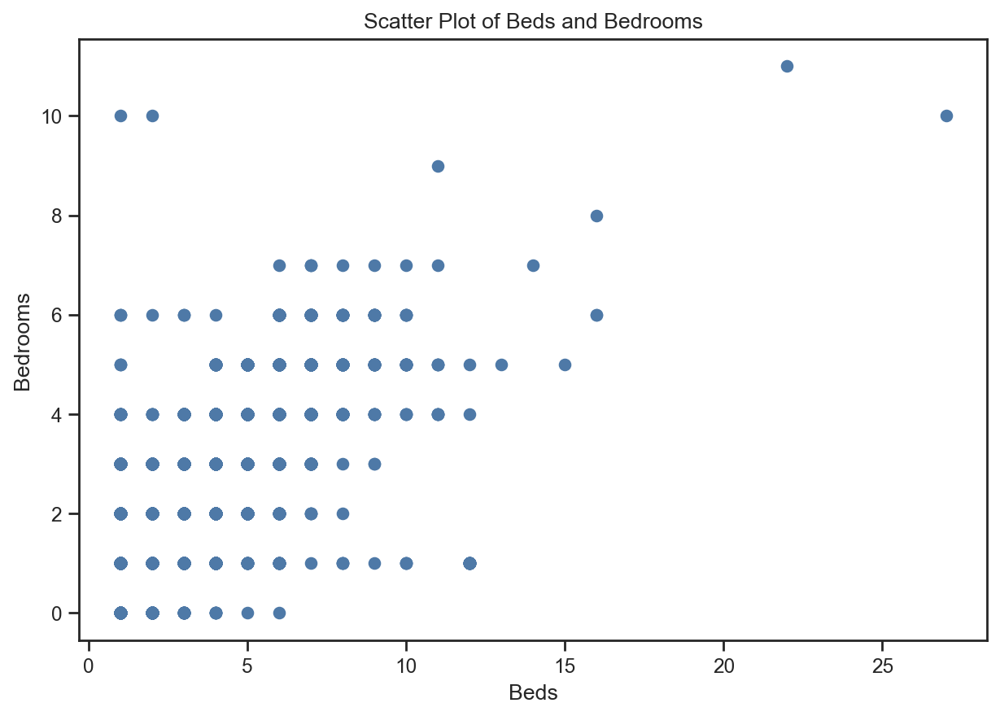

In [45]:
import matplotlib.pyplot as plt

# Extract the data from the 'beds' and 'bedrooms' columns
beds = data['beds']
bedrooms = data['bedrooms']

# Create a scatter plot
plt.scatter(beds, bedrooms)

# Add title and axis labels
plt.title("Scatter Plot of Beds and Bedrooms")
plt.xlabel("Beds")
plt.ylabel("Bedrooms")

# Display the plot
plt.show()


In [46]:
# Calculate the mode of 'beds' based on 'bedrooms'
beds_mode = data.groupby('bedrooms')['beds'].apply(lambda x: x.mode()[0])

# Fill missing values in 'beds' with the corresponding mode based on 'bedrooms'
data['beds'] = data.groupby('bedrooms')['beds'].apply(lambda x: x.fillna(x.mode()[0]))

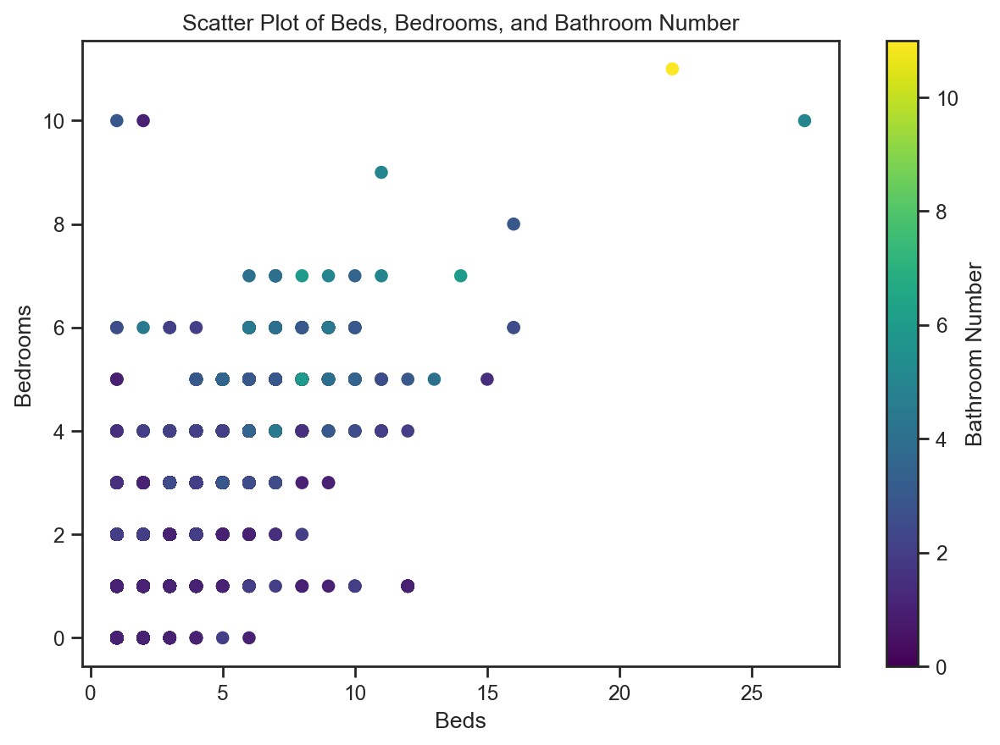

In [47]:
import matplotlib.pyplot as plt

# Extract the data from the columns
beds = data['beds']
bedrooms = data['bedrooms']
bathroom_number = data['bathroom_number']

# Create a scatter plot
plt.scatter(beds, bedrooms, c=bathroom_number, cmap='viridis')

# Add colorbar
plt.colorbar(label='Bathroom Number')

# Add title and axis labels
plt.title("Scatter Plot of Beds, Bedrooms, and Bathroom Number")
plt.xlabel("Beds")
plt.ylabel("Bedrooms")

# Show the plot
plt.show()

In [48]:
# Calculate the mode of "bathroom_number" for each unique value of "bedrooms"
bathroom_mode = data.groupby('bedrooms')['bathroom_number'].agg(lambda x: x.mode().iloc[0])

# Fill missing values in "bathroom_number" with the mode corresponding to each "bedrooms"
data['bathroom_number'] = data.apply(lambda row: bathroom_mode[row['bedrooms']] if pd.isnull(row['bathroom_number']) else row['bathroom_number'], axis=1)


In [49]:
predictors = ['review_scores_rating','review_scores_accuracy', 'review_scores_cleanliness',
               'review_scores_checkin', 'review_scores_communication',
               'review_scores_location', 'review_scores_value']
###https://www.airbnb.com.au/help/article/1257
## value is does it worth the value

In [50]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

X_train = data.loc[:, predictors]
imputer =  IterativeImputer()
imputer.fit(X_train)
data[predictors] = imputer.transform(data[predictors])

In [51]:
data.shape

(22100, 61)

In [52]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22100 entries, 0 to 22099
Data columns (total 61 columns):
 #   Column                                        Non-Null Count  Dtype         
---  ------                                        --------------  -----         
 0   source                                        22100 non-null  object        
 1   description                                   22100 non-null  object        
 2   neighborhood_overview                         22100 non-null  int64         
 3   host_since                                    22100 non-null  float64       
 4   host_location                                 22100 non-null  int64         
 5   host_about                                    22100 non-null  object        
 6   host_response_time                            22100 non-null  object        
 7   host_response_rate                            22100 non-null  float64       
 8   host_acceptance_rate                          22100 non-null  floa

In [53]:
data.head()

,source,description,neighborhood_overview,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bathroom_number,bathroom_type,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,end_2022,review_time_gap
0,city scrape,Very central to the city which can be reached ...,0,4847.0,1,"Recently retired, I've lived & worked on 4 con...",within an hour,100.0,100.0,0.0,Potts Point,1.0,1.0,2,0.0,Sydney,-33.86767,151.22497,Private room in rental unit,Private room,1,1 shared bath,1.0,2,1.0,1.0,"[""Hair dryer"", ""Refrigerator"", ""Bed linens"", ""...",65.0,90,180,90,90,180,180,90.0,180.0,1,29,59,89,364,2022-12-10,195,0,0,4.590000,4.760000,4.300000,4.800000,4.760000,4.820000,4.710000,0,0,1,0,1,0,1.23,2022-12-31,3751.0
1,city scrape,"Beautifully renovated, spacious and quiet, our...",0,4789.0,1,I am a Canadian who has made Australia her hom...,within a few hours,100.0,84.0,0.0,Other,2.0,2.0,2,1.0,Manly,-33.80084,151.26378,Entire home,Entire home/apt,6,3 baths,3.0,0,3.0,3.0,"[""Hair dryer"", ""Dryer"", ""Refrigerator"", ""Firep...",470.0,2,22,2,2,22,22,2.0,22.0,1,0,0,0,0,2022-12-10,3,0,0,4.670000,4.330000,4.330000,4.670000,4.330000,4.670000,4.330000,1,0,2,2,0,0,0.04,2022-12-31,1977.0
2,city scrape,You will be staying in a unique duplex apartme...,0,4776.0,1,I am originally Scottish but I have made Sydne...,within an hour,100.0,100.0,1.0,Darlinghurst,2.0,6.0,2,1.0,Sydney,-33.87964,151.21680,Private room in condo,Private room,2,1 private bath,1.0,1,1.0,1.0,"[""Hair dryer"", ""Dining table"", ""Board games"", ...",102.0,1,90,1,1,1125,1125,1.0,1125.0,1,2,15,24,277,2022-12-10,457,73,8,4.490000,4.630000,4.460000,4.790000,4.710000,4.740000,4.510000,1,1,2,1,1,0,3.48,2022-12-31,3934.0
3,previous scrape,You will love this retro Palm Beach cottage fr...,0,3825.0,1,Easy going and fun loving. Blessed to live in ...,within an hour,100.0,98.0,0.0,Palm Beach,2.0,2.0,2,1.0,Pittwater,-33.60319,151.33141,Entire cabin,Entire home/apt,4,1.5 baths,1.5,0,2.0,4.0,"[""Hair dryer"", ""Dining table"", ""Refrigerator"",...",750.0,2,1125,2,4,1125,1125,2.2,1125.0,1,0,0,0,0,2022-12-10,93,11,0,4.840000,4.830000,4.840000,4.980000,4.950000,4.930000,4.770000,1,0,1,1,0,0,0.90,2022-12-31,3063.0
4,previous scrape,<>The space</>< />Come and stay in my bright a...,1,3674.0,0,"Hi, I'm Lorna. I'm a young 52 year old have be...",Not Provided,100.0,100.0,0.0,Not Provided,1.0,4.0,2,1.0,Warringah,-33.75705,151.29197,Private room in rental unit,Private room,2,1 shared bath,1.0,2,1.0,1.0,"[""Hair dryer"", ""Dryer"", ""Long term stays allow...",140.0,90,1125,90,90,1125,1125,90.0,1125.0,1,0,0,0,0,2022-12-10,0,0,0,4.503398,4.610816,4.453664,4.736751,4.723125,4.751394,4.496679,0,1,1,0,1,0,0.00,2022-12-31,0.0


In [54]:
#furthur drop some irrelavent columns
drop_irr_cat = ['bathrooms_text','calendar_last_scraped','end_2022']
data = data.drop(drop_irr_cat, axis = 1)

In [55]:
data.shape

(22100, 58)

## EDA and Feature Engineering

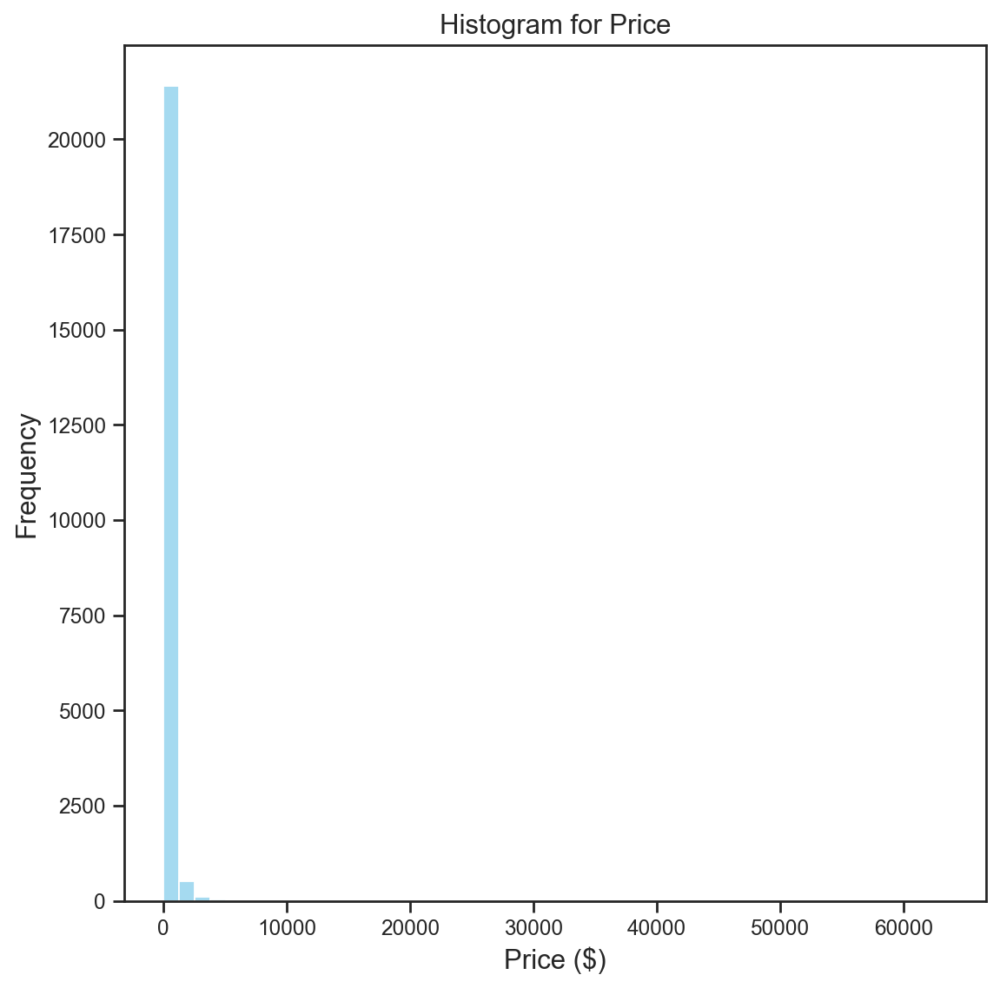

In [56]:
# target variable
plt.figure(figsize=(8,8))
sns.histplot(data=data, x="price", bins=50, color='Skyblue')
plt.xlabel('Price ($)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.ticklabel_format(axis='both', style='plain')
plt.title('Histogram for Price', fontsize=14)
plt.show()
#plt.savefig("p1")

In [57]:
#strongly skew to the right -> log transformation
#first remove all 0
data = data[data['price'] != 0]

In [58]:
data['log_price'] = np.log(data['price'])

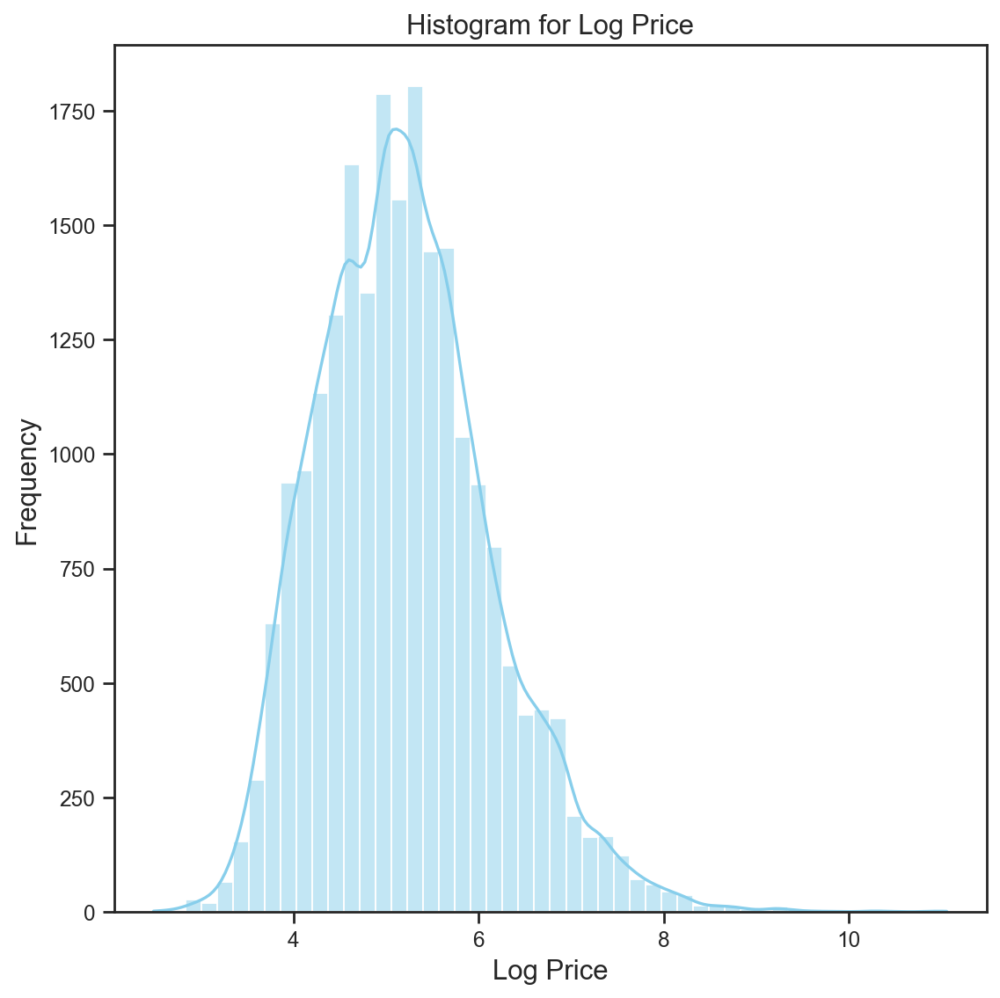

In [59]:
#strongly skew to the right -> log transformation
plt.figure(figsize=(8,8))
sns.histplot(data=data, x="log_price", bins=50, color='Skyblue', kde=True)
plt.xlabel('Log Price', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.ticklabel_format(axis='both', style='plain')
plt.title('Histogram for Log Price', fontsize=14)
plt.show()
#plt.savefig("p2")

In [60]:
from sklearn.model_selection import train_test_split

# Splitting into train and test sets
train_data, test_data, train_labels, test_labels = train_test_split(data, data['log_price'], test_size=0.2, random_state=42)

# Splitting the train set into train and validation sets
train_data, val_data, train_labels, val_labels = train_test_split(train_data, train_labels, test_size=0.2, random_state=42)

### **Categorical data**


In [61]:
train = train_data

In [62]:
# !pip install wordcloud

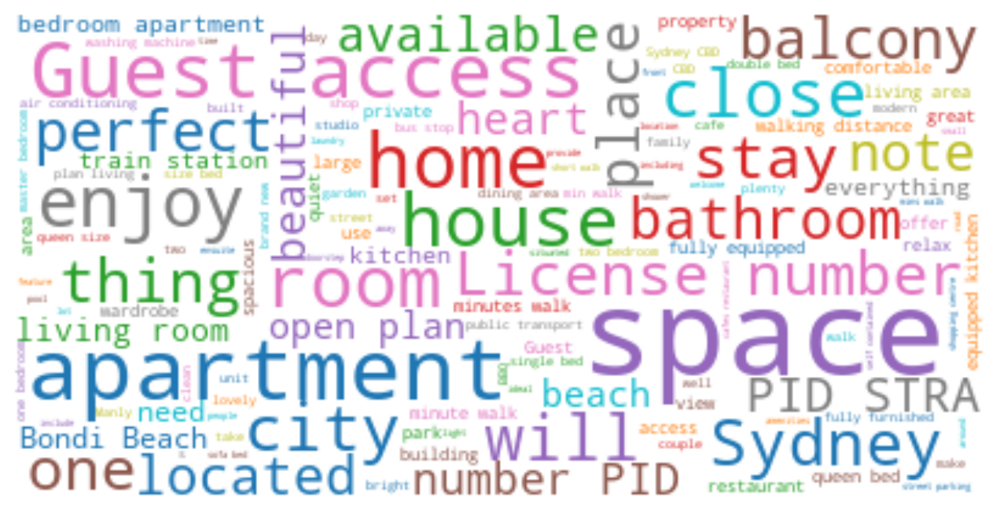

In [63]:
#to see the most frequent descriptions

from wordcloud import WordCloud




description = train['description']
description = ''.join(description)

fig, ax = plt.subplots(figsize=(10, 8))
wordcloud = WordCloud(max_font_size=50,max_words=200,background_color="white", colormap='tab10').generate(description)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()
#https://www.datacamp.com/tutorial/wordcloud-python

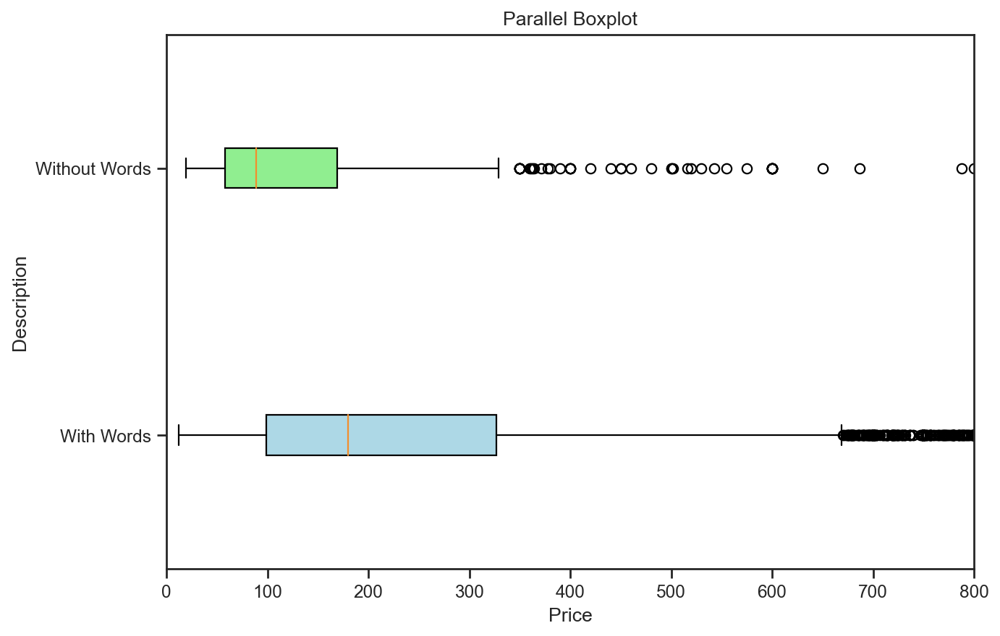

In [64]:
frequent_words1 = ['space', 'Sydney', 'apartment', 'enjoy', 'Guest', 'home', 'perfect', 'balcony', 'bathroom', 'beach', 'close', 'things']  # List of frequent words

fil_description1 = train['description'].str.contains('|'.join(frequent_words1), case=False) 
#https://www.shecancode.io/blog/filter-a-pandas-dataframe-by-a-partial-string-or-pattern-in-8-ways

fil_data1 = train[fil_description1]

prices_words1 = fil_data1['price']
prices_nowords1 = train.loc[~fil_description1, 'price']

fig, ax = plt.subplots()

boxplot = ax.boxplot([prices_words1, prices_nowords1], vert=False, patch_artist=True)

ax.set_yticklabels(['With Words', 'Without Words'])

#set color
colors = ['lightblue', 'lightgreen']
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)
    
#https://matplotlib.org/stable/gallery/statistics/boxplot_color.html
    
ax.set_xlabel('Price')
ax.set_ylabel('Description')
ax.set_title('Parallel Boxplot')

ax.set_xlim(0, 800)

plt.show()

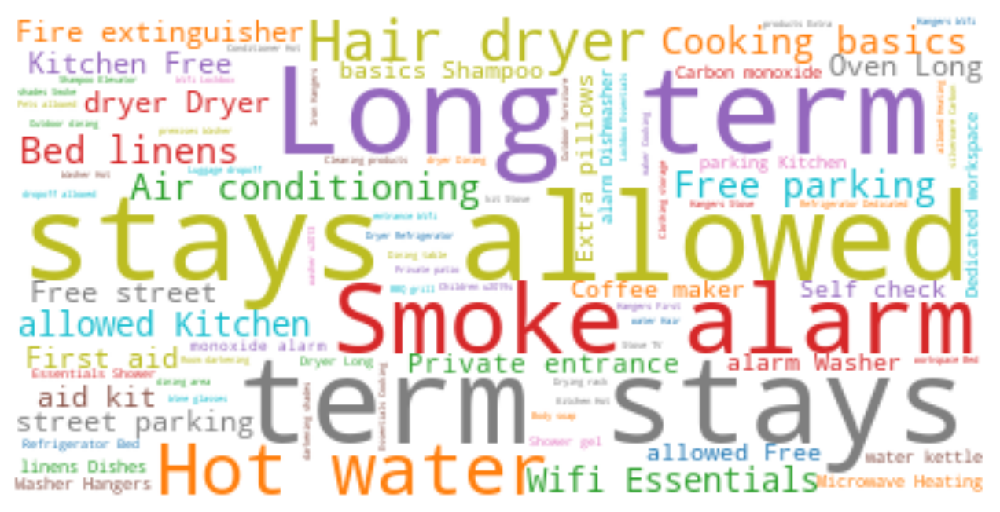

In [65]:
#to see the most frequent amenities

from wordcloud import WordCloud
import matplotlib.pyplot as plt

amenities = train['amenities']
amenities = [str(item) for item in amenities]  # Convert float values to strings
amenities = ''.join(amenities)

fig, ax = plt.subplots(figsize=(10, 8))
wordcloud = WordCloud(max_font_size=50, max_words=200, background_color="white", colormap='tab10').generate(amenities)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()
#https://www.datacamp.com/tutorial/wordcloud-python

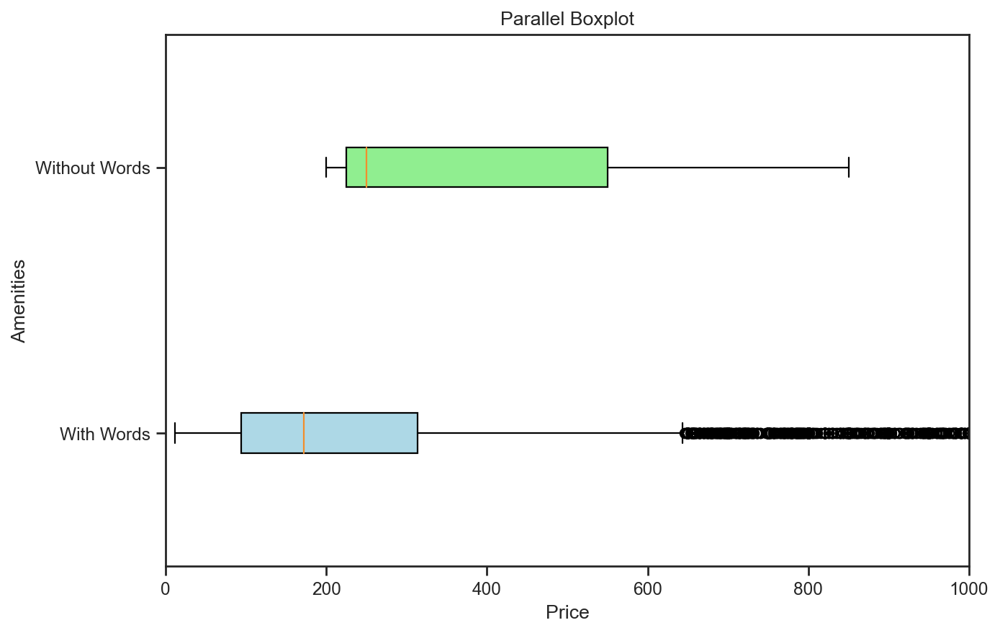

In [66]:
frequent_words2 = ['Long term', 'Smoke alarm', 'stays allowed', 'Hot water', 'Cooking basics', 'Bed linens', 'Hair dryer', 'Wifi Essentials', 'Free parking', 'allowed Kitchen', 'Air conditioning','dryer','Fire extinguisher','stays','allowed','coffee maker']  # List of frequent words

fil_description2 = train['amenities'].str.contains('|'.join(frequent_words2), case=False) 
#https://www.shecancode.io/blog/filter-a-pandas-dataframe-by-a-partial-string-or-pattern-in-8-ways

fil_data2 = train[fil_description2]

prices_words2 = fil_data2['price']
prices_nowords2 = train.loc[~fil_description2, 'price']

fig, ax = plt.subplots()

boxplot = ax.boxplot([prices_words2, prices_nowords2], vert=False, patch_artist=True)

ax.set_yticklabels(['With Words', 'Without Words'])

#set color
colors = ['lightblue', 'lightgreen']
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)
    
#https://matplotlib.org/stable/gallery/statistics/boxplot_color.html
    
ax.set_xlabel('Price')
ax.set_ylabel('Amenities')
ax.set_title('Parallel Boxplot')

ax.set_xlim(0, 1000)

plt.show()

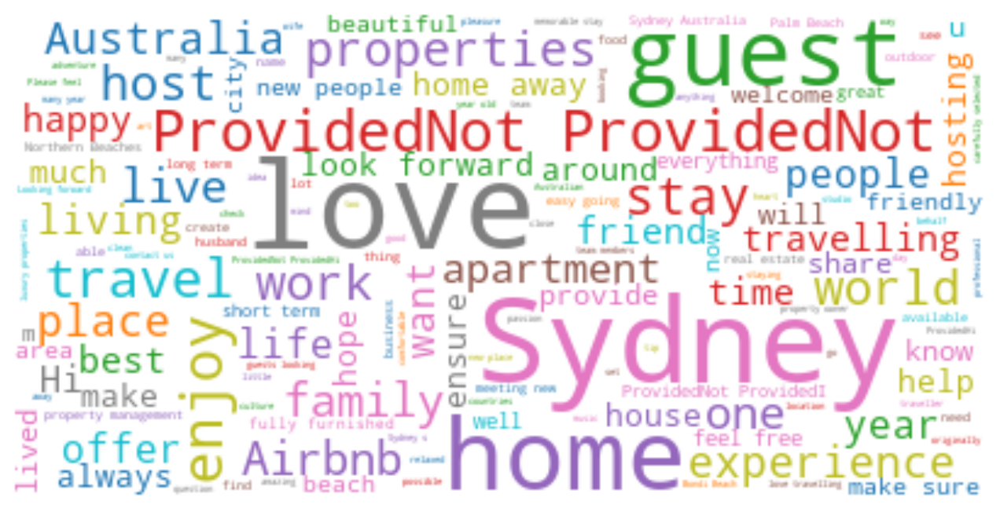

In [67]:
#host about
from wordcloud import WordCloud

host_about = train['host_about']
host_about = ''.join(host_about)

fig, ax = plt.subplots(figsize=(10, 8))
wordcloud = WordCloud(max_font_size=50,max_words=200,background_color="white", colormap='tab10').generate(host_about)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


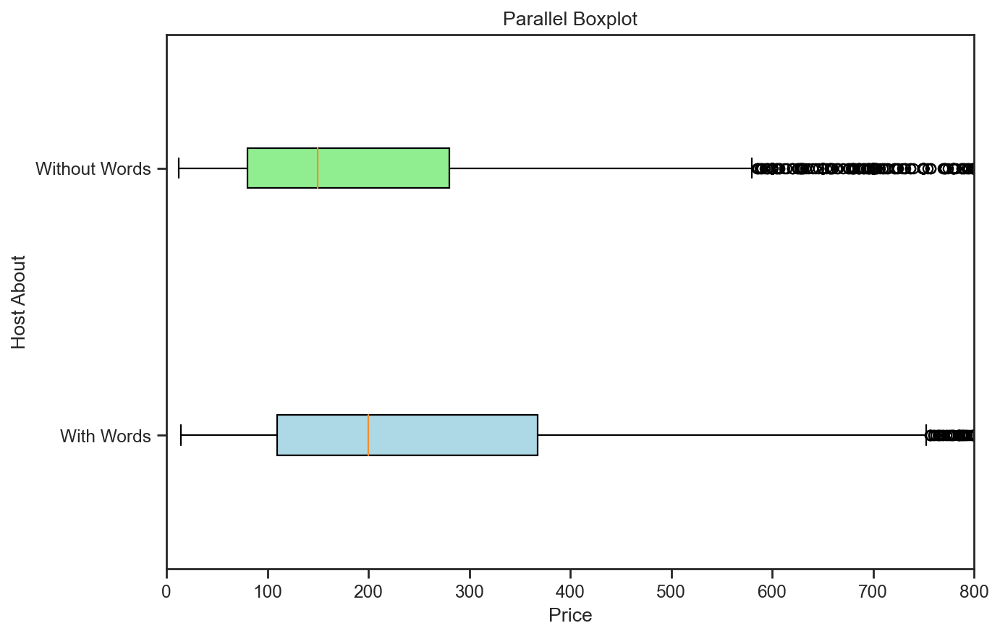

In [68]:
frequent_words3 = ['Sydney','love','home','guest','enjoy','Australia','properties','travelling','life','happy','hope','work','apartment','best','friend','time','short term']  # List of frequent words

fil_description3 = train['host_about'].str.contains('|'.join(frequent_words3), case=False) 
#https://www.shecancode.io/blog/filter-a-pandas-dataframe-by-a-partial-string-or-pattern-in-8-ways

fil_data3 = train[fil_description3]

prices_words3 = fil_data3['price']
prices_nowords3 = train.loc[~fil_description3, 'price']

fig, ax = plt.subplots()

boxplot = ax.boxplot([prices_words3, prices_nowords3], vert=False, patch_artist=True)

ax.set_yticklabels(['With Words', 'Without Words'])

#set color
colors = ['lightblue', 'lightgreen']
for patch, color in zip(boxplot['boxes'], colors):
    patch.set_facecolor(color)
    
#https://matplotlib.org/stable/gallery/statistics/boxplot_color.html
    
ax.set_xlabel('Price')
ax.set_ylabel('Host About')
ax.set_title('Parallel Boxplot')

ax.set_xlim(0, 800)

plt.show()

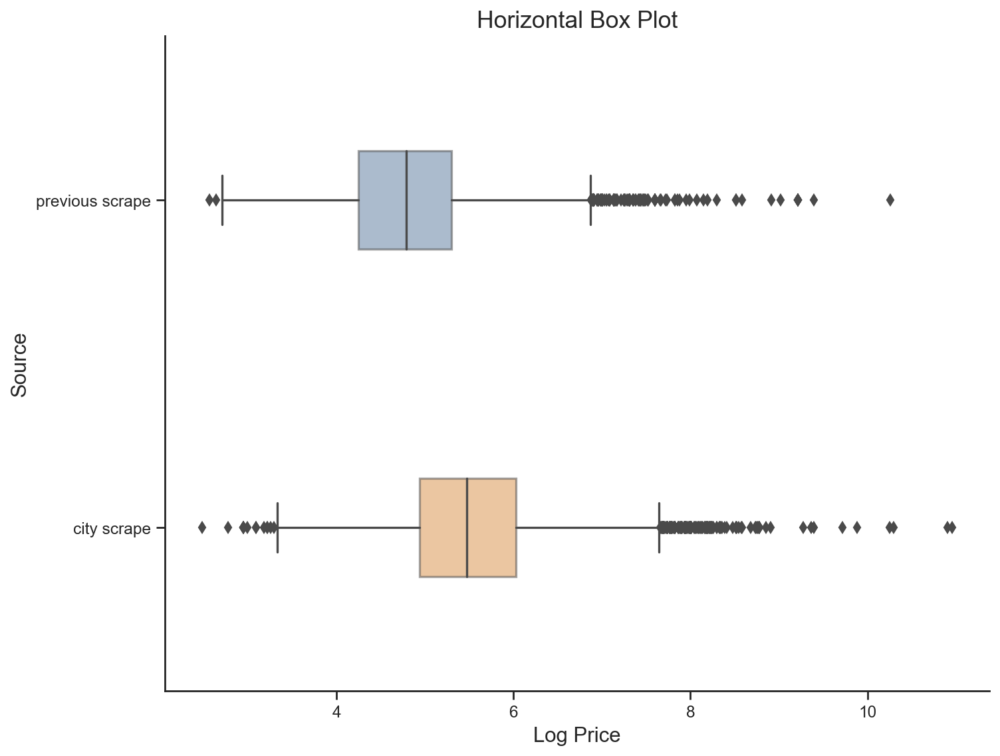

In [69]:
#souece & log_price
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['source'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('Source',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()

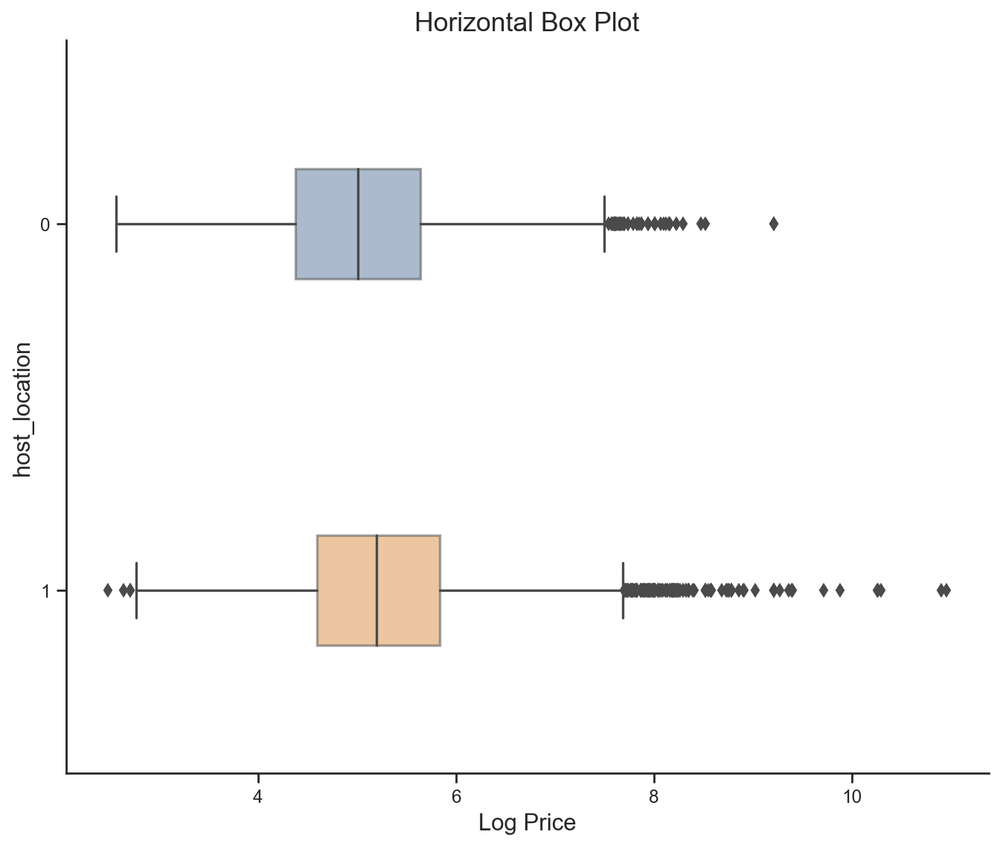

In [70]:
#host_location & log price
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['host_location'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('host_location',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()
##the properties which the hosts are in AU have higher prices.

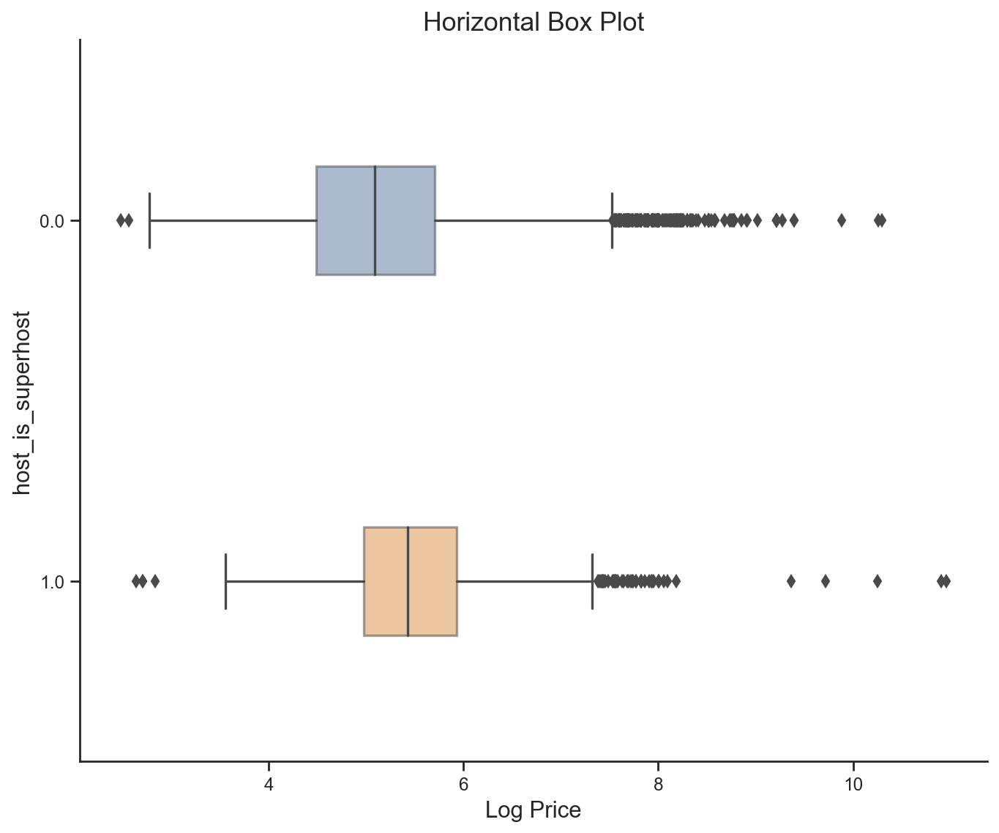

In [71]:
#superhost or not & log price
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['host_is_superhost'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('host_is_superhost',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()

In [72]:
#host_verifications & price
import plotly.express as px

values = train.groupby('host_verifications')['price'].mean().values
names = train.groupby('host_verifications')['price'].mean().index

fig = px.pie(values = values, names = names, title = 'Proportion of different number of host verification')
fig.show()
#the host with 3 verification implies higher prices

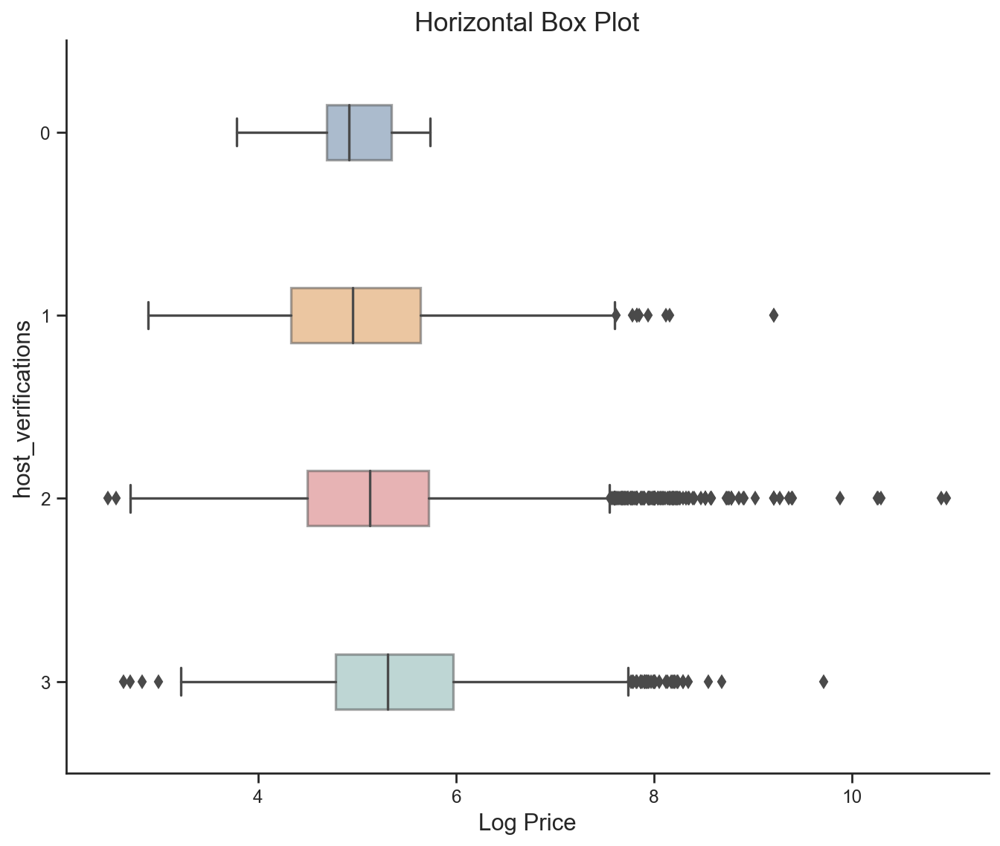

In [73]:
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['host_verifications'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('host_verifications',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()

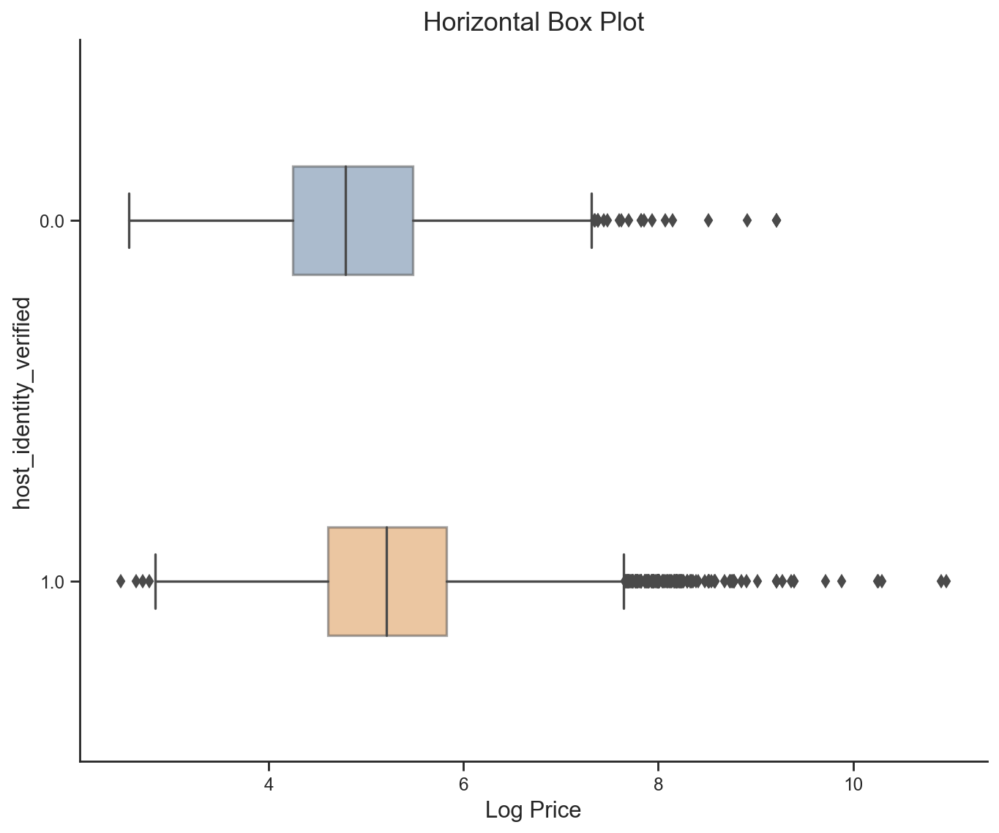

In [74]:
#host_identity_verified & log_price
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['host_identity_verified'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('host_identity_verified',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()
#false -> lower price; true -> higher price

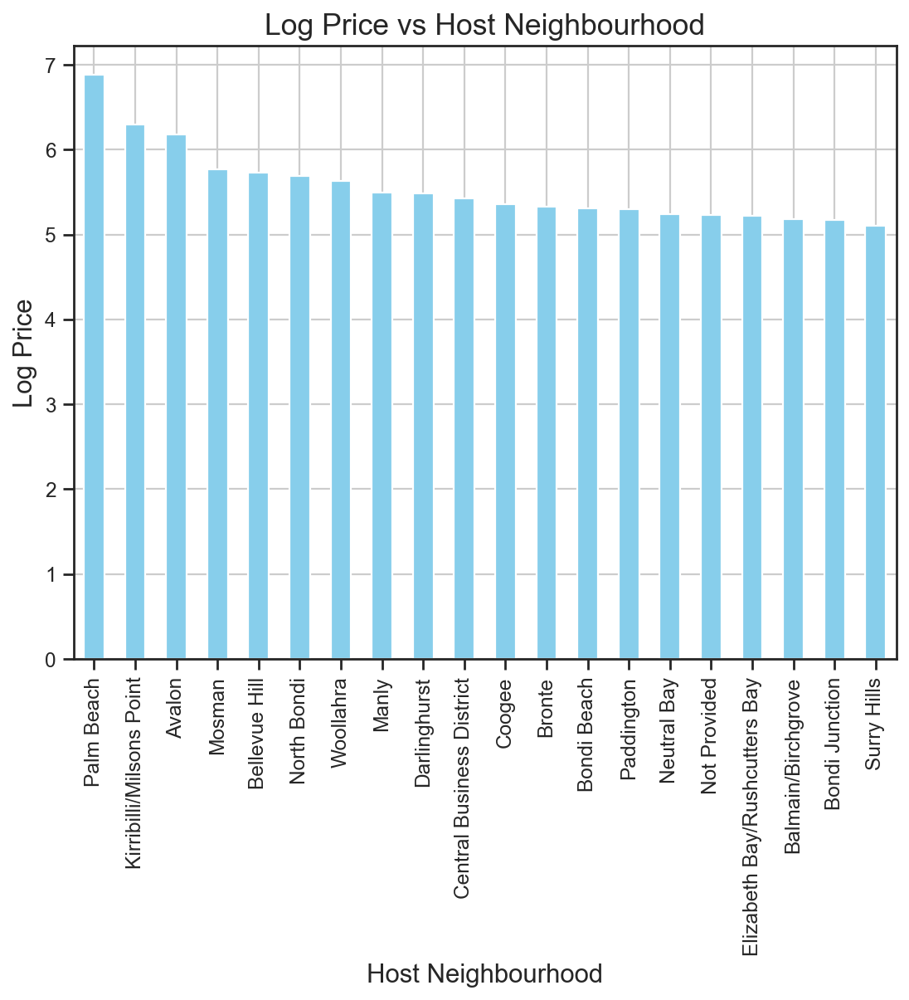

In [75]:
#host_neighbourhood
plt.figure(figsize=(8,6))
train.groupby('host_neighbourhood')['log_price'].mean().sort_values(ascending=False).head(20).plot.bar(color='skyblue')
plt.xlabel('Host Neighbourhood', fontsize=14)
plt.ylabel('Log Price', fontsize=14)
plt.title('Log Price vs Host Neighbourhood', fontsize=16)
plt.ticklabel_format(axis='y', style='plain')
plt.grid()
plt.show()
#the properties near the scenic spot are relatively expensive

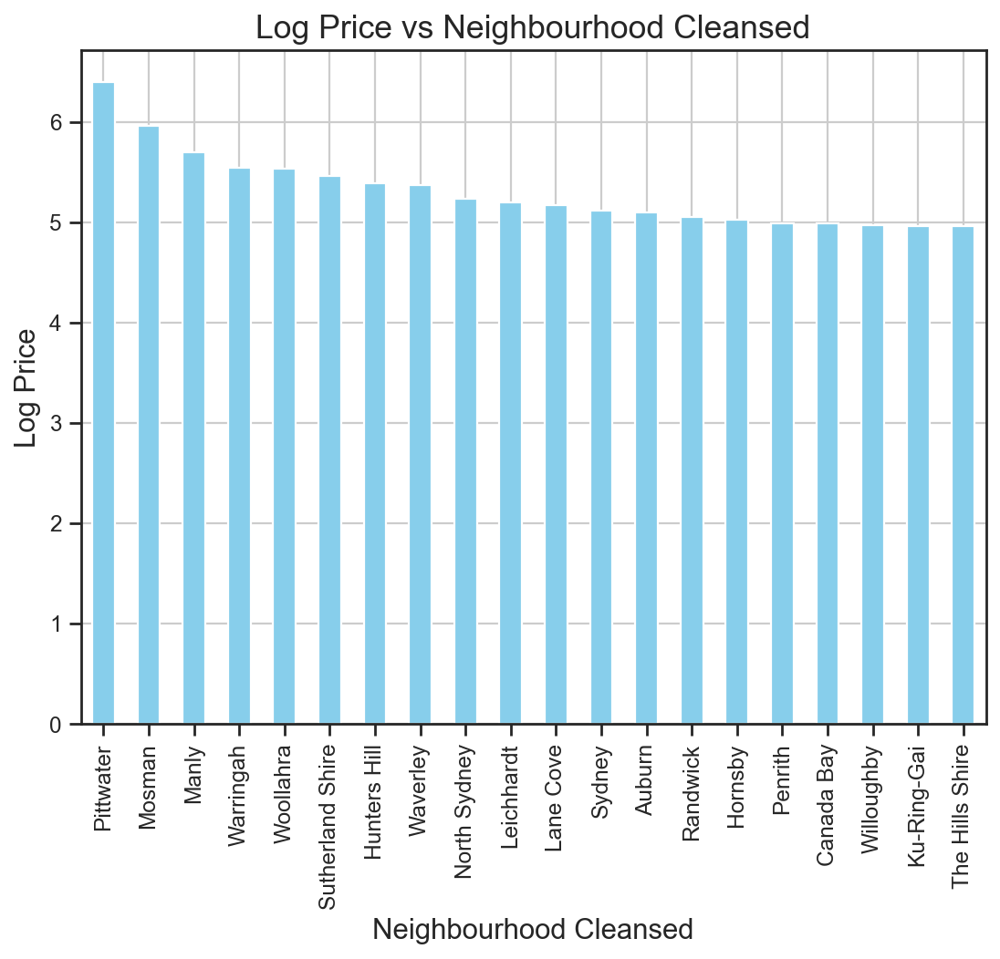

In [76]:
#neighbourhood_cleansed
plt.figure(figsize=(8,6))
train.groupby('neighbourhood_cleansed')['log_price'].mean().sort_values(ascending=False).head(20).plot.bar(color='skyblue')
plt.xlabel('Neighbourhood Cleansed', fontsize=14)
plt.ylabel('Log Price', fontsize=14)
plt.title('Log Price vs Neighbourhood Cleansed', fontsize=16)
plt.ticklabel_format(axis='y', style='plain')
plt.grid()
plt.show()
#the properties near the scenic spot are relatively expensive

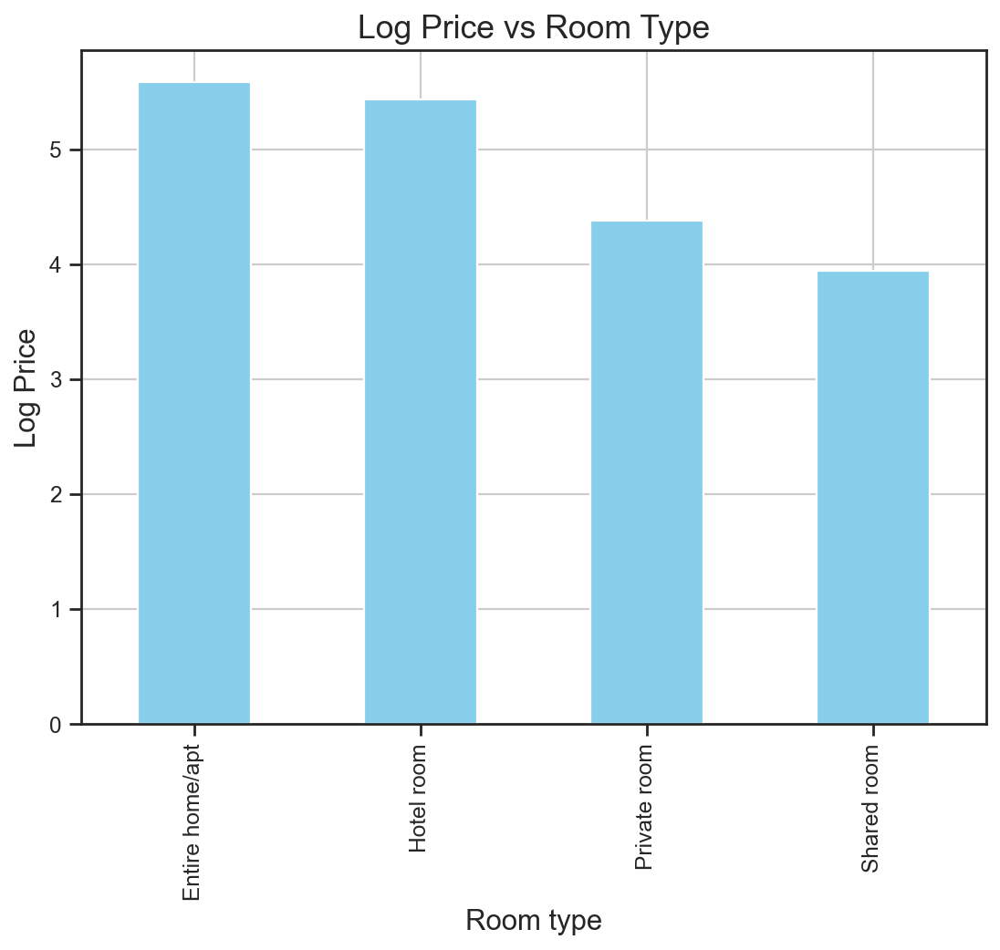

In [77]:
#room_type
plt.figure(figsize=(8,6))
train.groupby('room_type')['log_price'].mean().sort_values(ascending=False).head(20).plot.bar(color='skyblue')
plt.xlabel('Room type', fontsize=14)
plt.ylabel('Log Price', fontsize=14)
plt.title('Log Price vs Room Type', fontsize=16)
plt.ticklabel_format(axis='y', style='plain')
plt.grid()
plt.show()

In [78]:
#room_type
values = train.groupby('room_type')['log_price'].mean().values
names = train.groupby('room_type')['log_price'].mean().index

fig = px.pie(values = values, names = names, title = 'Porportion of Room Type')
fig.show()

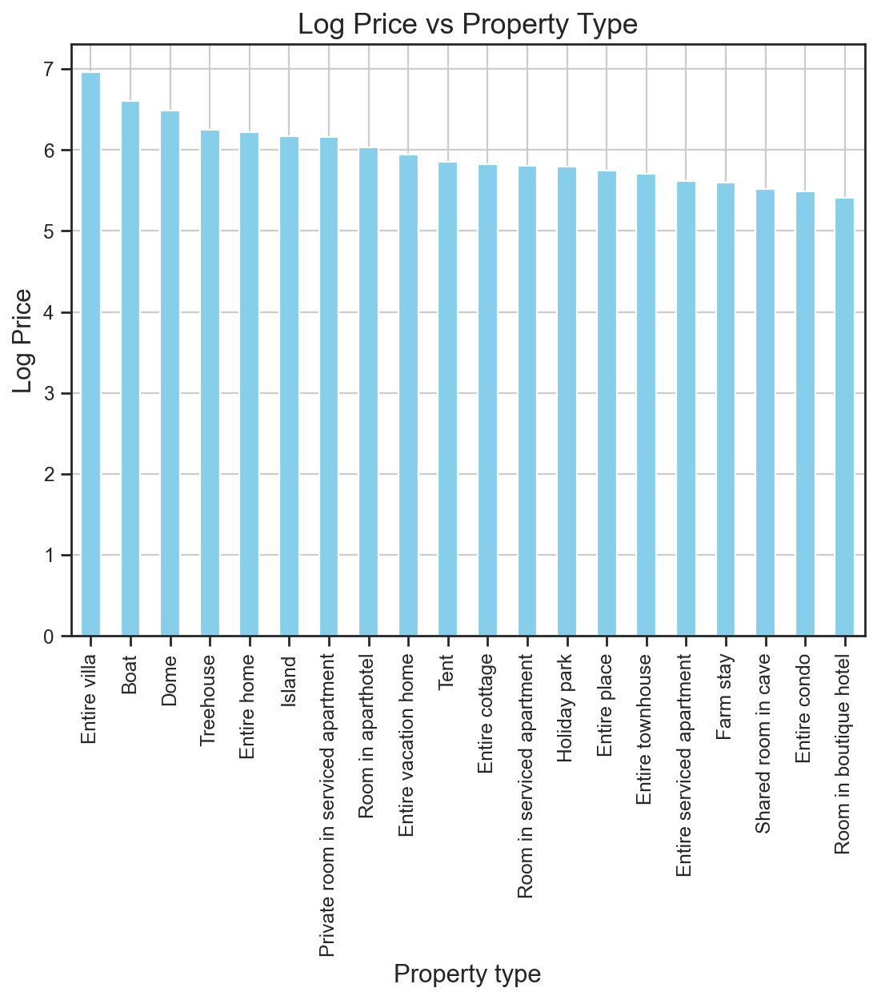

In [79]:
#property_type
plt.figure(figsize=(8,6))
train.groupby('property_type')['log_price'].mean().sort_values(ascending=False).head(20).plot.bar(color='skyblue')
plt.xlabel('Property type', fontsize=14)
plt.ylabel('Log Price', fontsize=14)
plt.title('Log Price vs Property Type', fontsize=16)
plt.ticklabel_format(axis='y', style='plain')
plt.grid()
plt.show()

In [80]:
train['has_availability'].value_counts()
#meaningless to analyse

1    14059
0       85
Name: has_availability, dtype: int64

In [81]:
train['instant_bookable'].value_counts()

0    9774
1    4370
Name: instant_bookable, dtype: int64

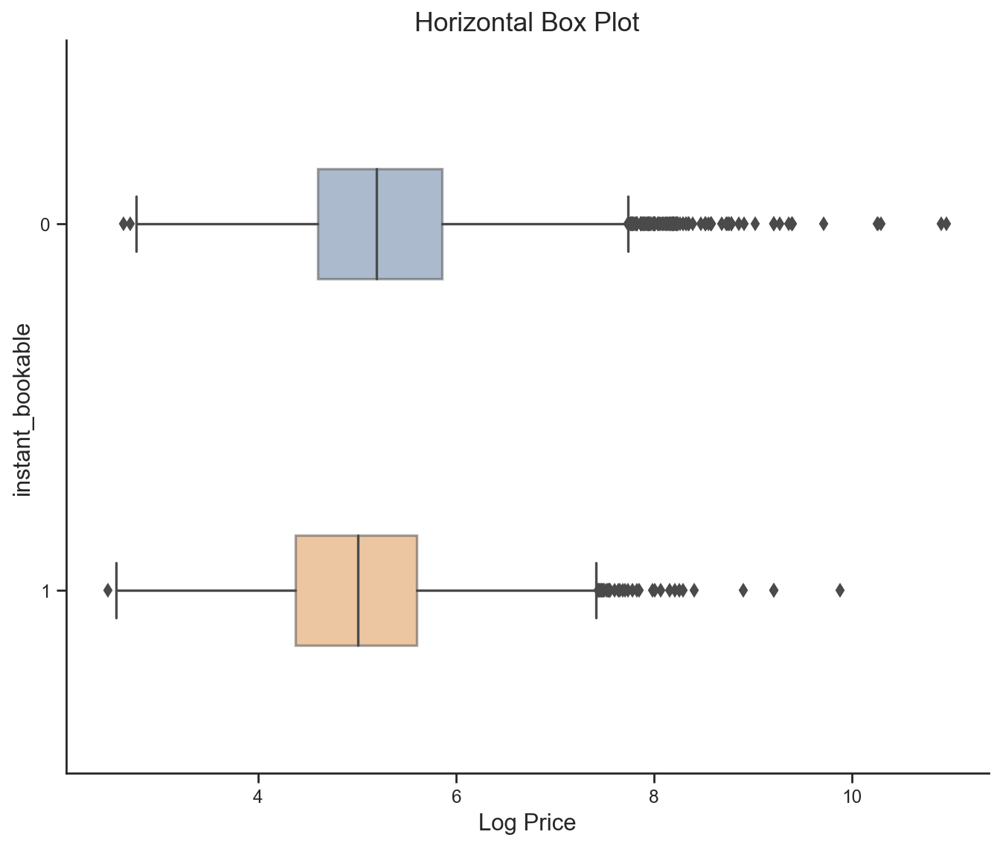

In [82]:
#can instanct book  
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['instant_bookable'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('instant_bookable',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()
## the properties which need to be accepted by host has lower price

In [83]:
#if there is neighborhood overview
train.groupby(["neighborhood_overview"])["log_price"].mean()

neighborhood_overview
0    5.276126
1    5.120007
Name: log_price, dtype: float64

In [84]:
train.groupby(["neighborhood_overview"])["price"].mean()
#no obviouse difference, can be ignored. 

neighborhood_overview
0    324.720791
1    325.648237
Name: price, dtype: float64

In [85]:
train.groupby(["license"])["log_price"].mean()

license
0    4.816006
1    5.626283
Name: log_price, dtype: float64

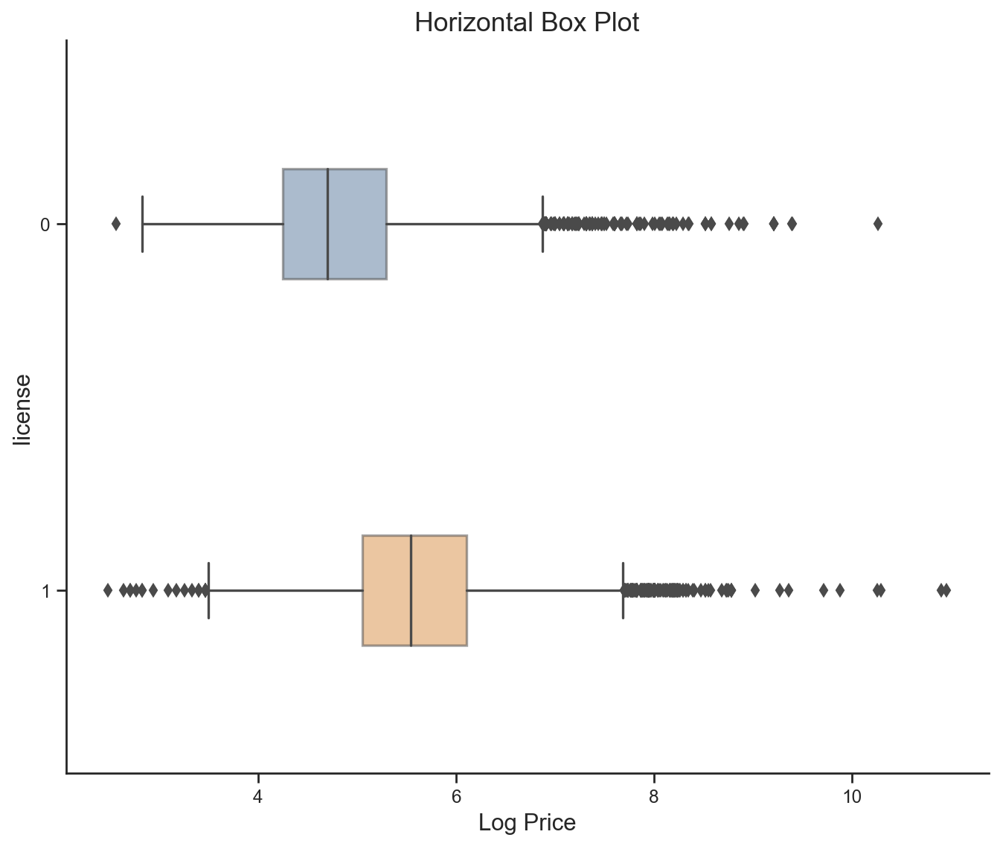

In [86]:
fig, ax = plt.subplots(figsize = (10,8))

sns.boxplot(y = train['license'], x = train['log_price'],orient='h', width=0.3, boxprops = dict(alpha=0.5))

ax.set_xlabel('Log Price', fontsize=14)
ax.set_ylabel('license',fontsize=14)
ax.set_title('Horizontal Box Plot',fontsize=16)

sns.despine()

**Interaction between two categorical variables**

In [87]:
pd.crosstab(train["host_location"], train["host_is_superhost"], values = train["log_price"], aggfunc = np.mean)
#if the host is superhost and his/her location is in AU, the price is higher

host_is_superhost,0.0,1.0
host_location,,
0,5.051913,5.381800
1,5.228841,5.526467


In [88]:
pd.crosstab(train["host_identity_verified"], train["instant_bookable"], values = train["log_price"], aggfunc = np.mean)
#not instant book without acceptance and has verification -> higher price

instant_bookable,0,1
host_identity_verified,,
0.0,5.019603,4.683538
1.0,5.342405,5.123476


In [89]:
pd.crosstab(train["host_location"], train["instant_bookable"], values = train["log_price"], aggfunc = np.mean)
#not instant book without acceptance and the host in AU -> higher price

instant_bookable,0,1
host_location,,
0,5.143560,4.927447
1,5.349244,5.091784


### Describe of cleased data

In [90]:
float_columns = train_data.select_dtypes(include=['float']).columns.tolist()
numeral_data = train_data[float_columns]

In [91]:
continuous_columns = []  
dummy_columns = [] 
discrete_columns = [] 

for column in numeral_data.columns:
    value_counts = numeral_data[column].value_counts()
    column_values = numeral_data[column].values
    
    # Determine the data type based on the number of unique values and data type
    if len(value_counts) > 35:
        continuous_columns.append(column)  # Column is considered continuous if it has more than 20 unique values and float type
    elif len(value_counts) < 3:
        dummy_columns.append(column)  # Column is considered dummy if it has less than 3 unique values
    else:
        discrete_columns.append(column)  # Column is considered discrete for any other case

print("Column names of continuous variables:")
print(continuous_columns)
print('')

print("Column names of dummy variables:")
print(dummy_columns)
print('')

print("Column names of discrete variables:")
print(discrete_columns)


Column names of continuous variables:
['host_since', 'host_response_rate', 'host_acceptance_rate', 'host_listings_count', 'host_total_listings_count', 'latitude', 'longitude', 'price', 'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value', 'reviews_per_month', 'review_time_gap', 'log_price']

Column names of dummy variables:
['host_is_superhost', 'host_identity_verified']

Column names of discrete variables:
['bathroom_number', 'bedrooms', 'beds']


In [92]:
skewness = train_data.skew()
kurtosis = train_data.kurtosis()

describe_with_skew_kurt = train_data.describe().append(skewness.rename("skew")).append(kurtosis.rename("kurt"))

describe_with_skew_kurt.round(2)

,neighborhood_overview,host_since,host_location,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,latitude,longitude,accommodates,bathroom_number,bathroom_type,bedrooms,beds,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,review_time_gap,log_price
count,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,1.414400e+04,1.414400e+04,14144.00,1.414400e+04,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00,14144.00
mean,0.43,2399.75,0.69,96.37,92.91,0.12,17.98,32.51,2.05,0.82,-33.86,151.20,3.57,1.42,0.40,1.69,2.10,325.12,53.09,813.35,52.38,55.42,3.045384e+05,1.367365e+06,54.17,1.018325e+06,0.99,7.19,17.08,27.25,99.84,20.04,5.48,0.52,4.51,4.61,4.46,4.74,4.73,4.75,4.50,0.49,0.31,10.47,9.01,1.40,0.04,0.64,439.20,5.21
std,0.49,913.65,0.46,15.69,18.63,0.32,80.08,140.00,0.49,0.38,0.08,0.10,2.29,0.73,0.76,1.15,1.54,969.06,51.43,443.06,51.07,60.82,2.553543e+07,5.415542e+07,56.20,4.313895e+07,0.08,10.25,21.65,33.17,126.60,47.36,13.66,1.30,0.82,0.67,0.80,0.51,0.56,0.42,0.71,0.50,0.46,30.36,28.69,9.31,0.55,1.18,714.20,0.94
min,0.00,26.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-34.09,150.67,1.00,0.00,0.00,0.00,1.00,12.00,1.00,1.00,1.00,1.00,1.000000e+00,1.000000e+00,1.00,1.000000e+00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,2.48
25%,0.00,1799.00,0.00,100.00,98.00,0.00,1.00,1.00,2.00,1.00,-33.90,151.17,2.00,1.00,0.00,1.00,1.00,94.00,3.00,365.00,2.00,5.00,3.650000e+02,3.650000e+02,3.00,3.650000e+02,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4.50,4.61,4.45,4.74,4.72,4.75,4.50,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,4.54
50%,0.00,2517.00,1.00,100.00,100.00,0.00,1.00,2.00,2.00,1.00,-33.88,151.21,3.00,1.00,0.00,1.00,2.00,172.00,90.00,1125.00,90.00,90.00,1.125000e+03,1.125000e+03,90.00,1.125000e+03,1.00,0.00,3.00,8.00,31.00,3.00,0.00,0.00,4.60,4.71,4.50,4.84,4.85,4.80,4.54,0.00,0.00,1.00,1.00,0.00,0.00,0.08,47.00,5.15
75%,1.00,3030.00,1.00,100.00,100.00,0.00,4.00,6.00,2.00,1.00,-33.82,151.26,4.00,2.00,0.00,2.00,3.00,314.00,90.00,1125.00,90.00,90.00,1.125000e+03,1.125000e+03,90.00,1.125000e+03,1.00,12.00,34.00,55.00,180.00,16.00,4.00,0.00,4.93,5.00,4.92,5.00,5.00,5.00,4.86,1.00,1.00,3.00,2.00,1.00,0.00,0.79,612.25,5.75
max,1.00,4885.00,1.00,100.00,100.00,1.00,783.00,1339.00,3.00,1.00,-33.39,151.34,16.00,11.00,2.00,11.00,27.00,57250.00,1125.00,1500.00,1125.00,1125.00,2.147484e+09,2.147484e+09,1125.00,2.147484e+09,1.00,30.00,60.00,90.00,365.00,855.00,382.00,19.00,5.00,5.02,5.00,5.00,5.02,5.00,5.00,1.00,1.00,197.00,197.00,117.00,17.00,21.96,4357.00,10.96
skew,0.30,-0.33,-0.81,-5.27,-3.46,2.36,8.27,7.83,0.08,-1.67,1.09,-1.93,1.48,2.21,1.47,1.30,2.36,34.39,4.45,-0.80,4.12,7.42,8.409000e+01,3.961000e+01,5.75,4.457000e+01,-12.78,1.21,0.90,0.80,0.99,5.19,6.47,3.70,-4.30,-4.06,-3.61,-4.32,-4.30,-4.29,-3.81,0.06,0.83,4.50,4.88,11.94,24.19,3.64,1.96,0.59
kurt,-1.91,-0.20,-1.34,27.94,12.20,3.56,74.05,67.56,1.25,0.78,2.46,5.25,2.69,7.65,0.36,2.14,12.55,1712.51,83.19,-1.19,77

In [93]:
train_data.corr()['log_price'].sort_values().sort_values(ascending = False)

log_price                                       1.000000
accommodates                                    0.687373
bedrooms                                        0.638083
beds                                            0.577668
bathroom_number                                 0.515091
price                                           0.482413
license                                         0.429254
longitude                                       0.293877
latitude                                        0.254486
calculated_host_listings_count_entire_homes     0.232863
availability_365                                0.211923
availability_90                                 0.196408
availability_60                                 0.195523
calculated_host_listings_count                  0.187242
availability_30                                 0.158755
host_identity_verified                          0.149645
review_scores_location                          0.141465
host_total_listings_count      

### Figures of numerical data

### Plotly

In [94]:
#!pip install plotly
import plotly.express as px

fig = px.scatter(train_data,x = 'accommodates', y = 'log_price',trendline = 'lowess', color_discrete_sequence = colours)
fig.update_layout(template = 'plotly_white')
fig.show()

### Distribution plot

  0%|                                                  | 0/5559 [00:00<?, ?it/s]

  0%|                                                  | 0/5559 [00:00<?, ?it/s]


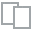
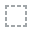
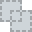
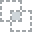
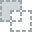
...
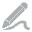
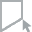
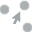
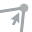
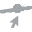

In [95]:
#!pip install dataprep
from dataprep.eda import plot

plot(train_data)

from IPython.display import display

display(plot(train_data))


### Regression Plot of Continuous Variables

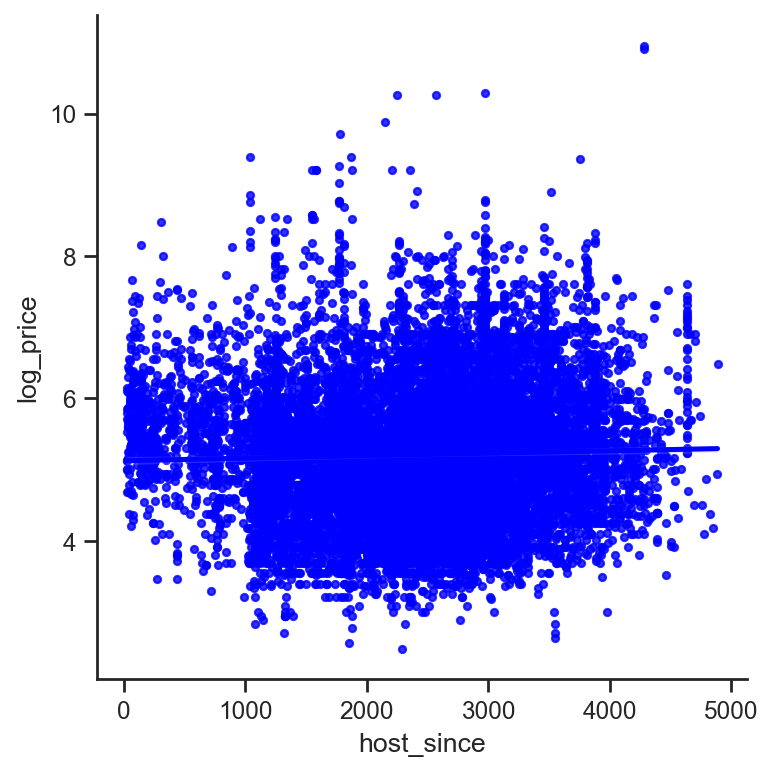

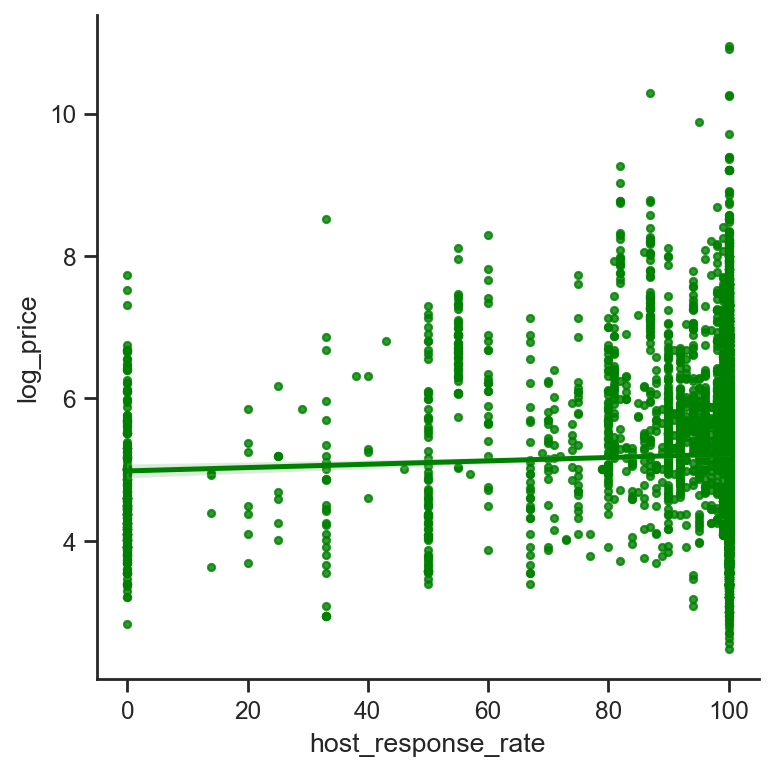

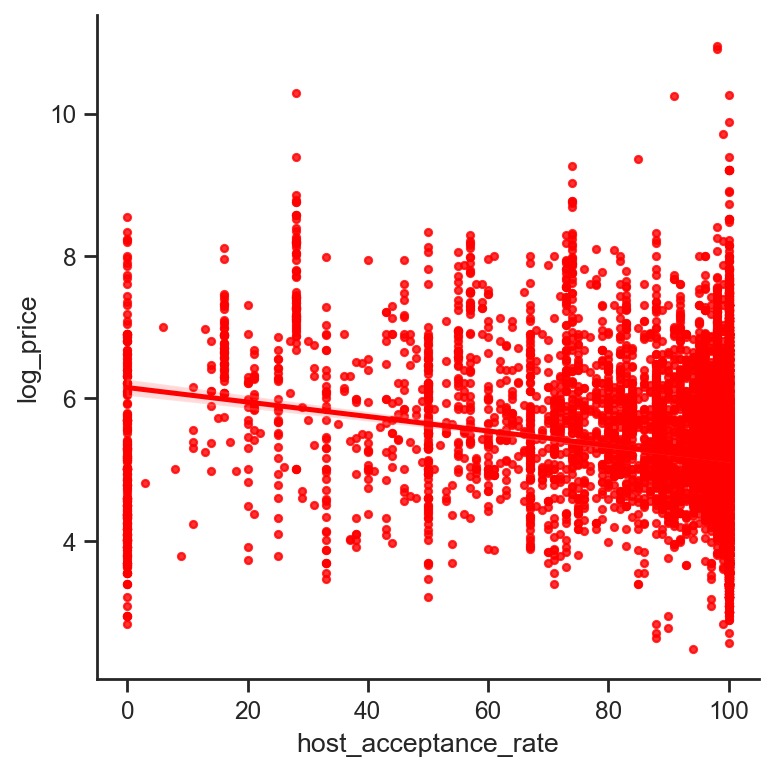

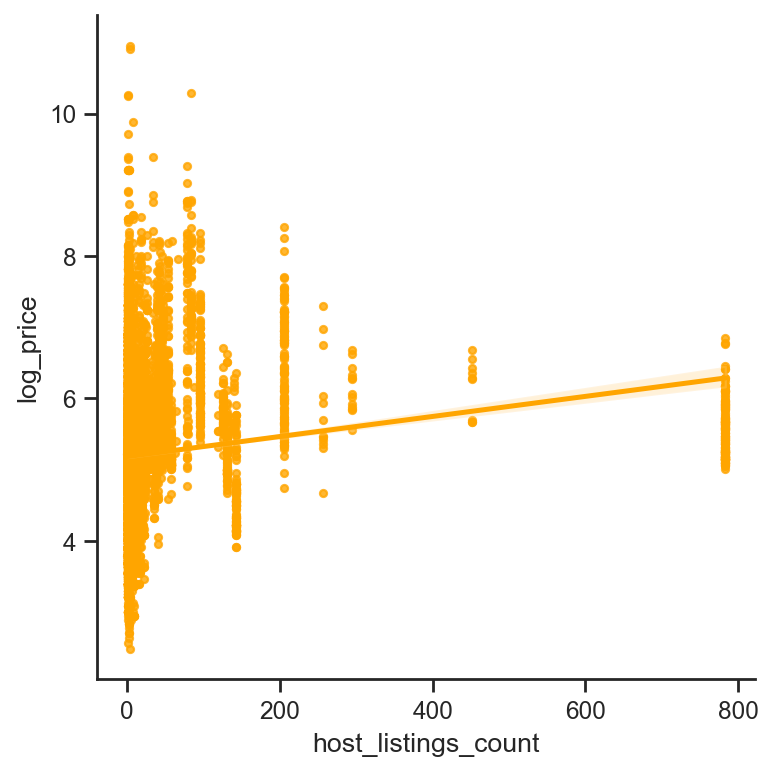

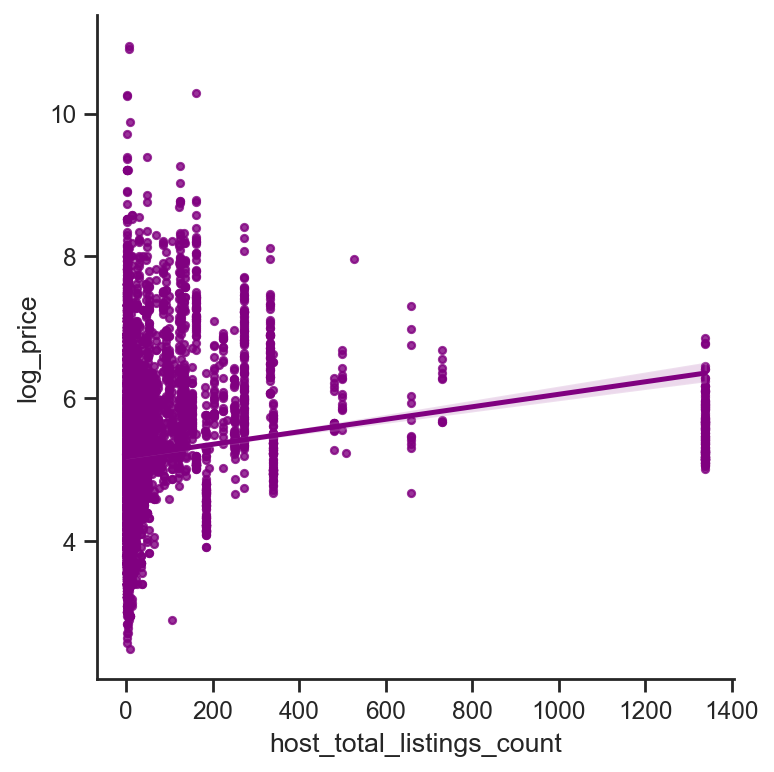

...

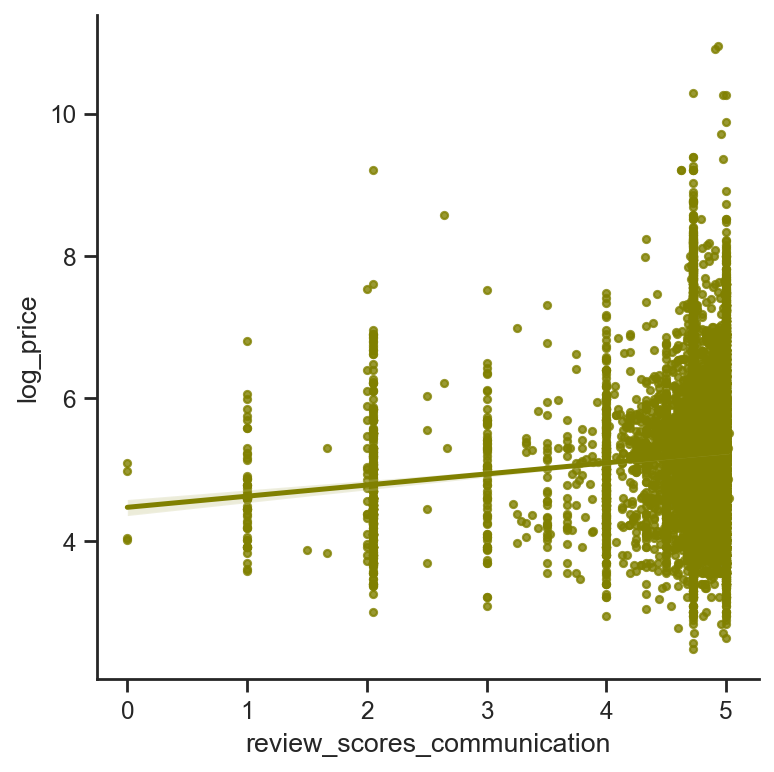

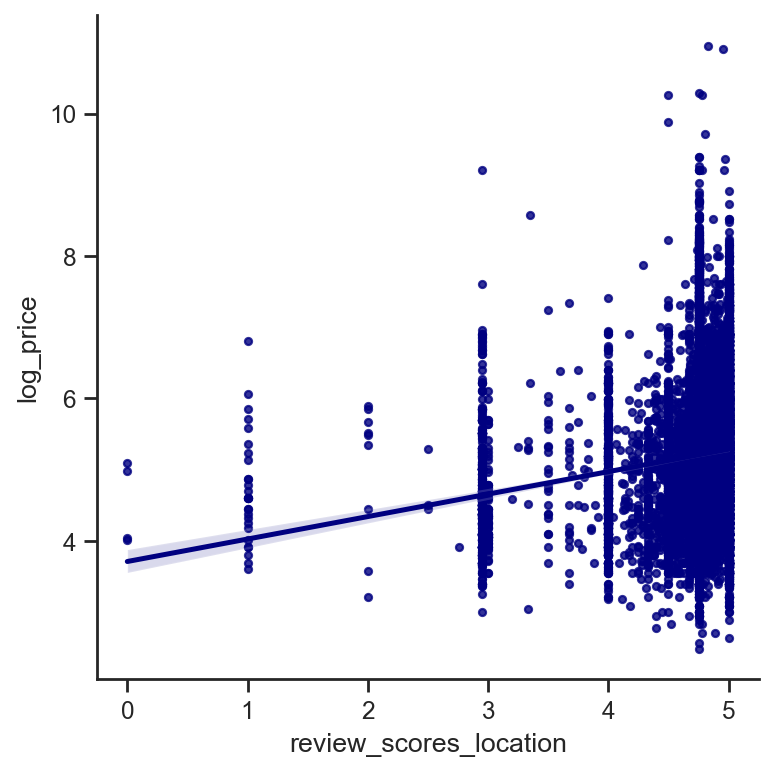

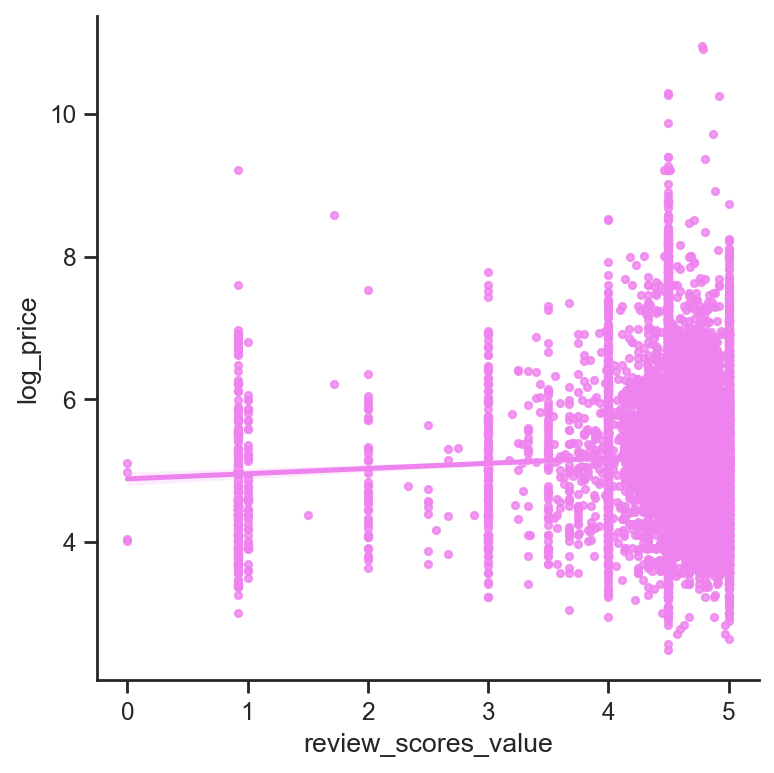

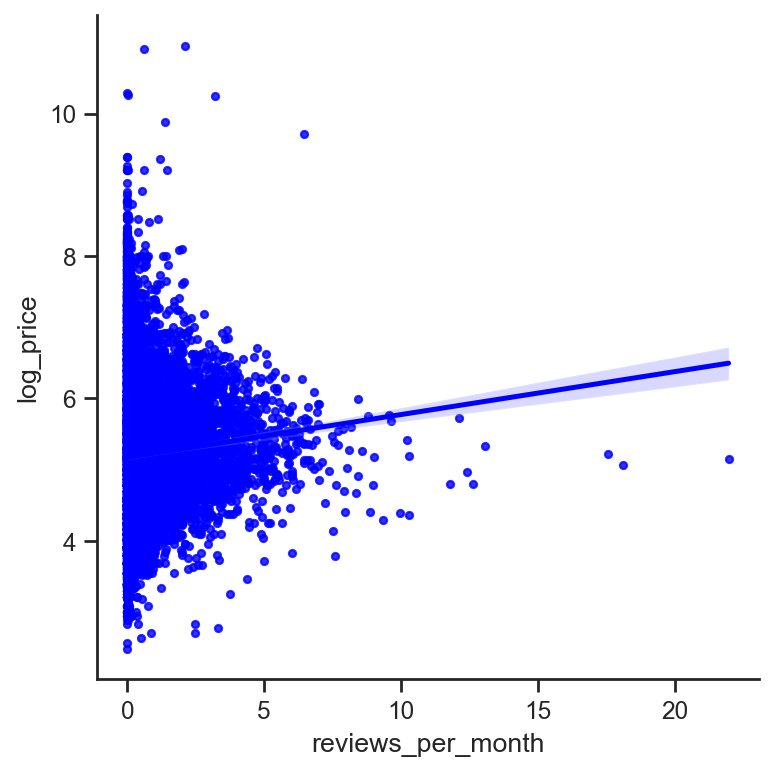

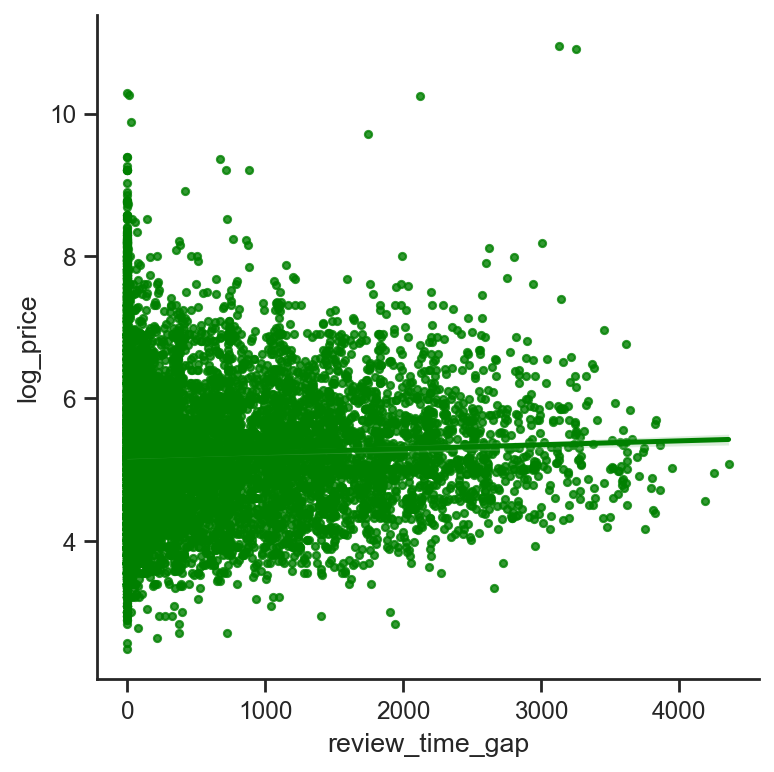

In [96]:
from itertools import cycle
continuous_columns.remove('log_price')
scatter_size = 10

color_palette = cycle(['blue', 'green', 'red', 'orange', 'purple', 'brown', 'pink', 'gray', 'cyan', 'magenta', 'yellow', 'teal', 'lime', 'indigo', 'olive', 'navy', 'violet'])

# Iterate over each variable in the continuous_columns list and create a scatter plot with regression line
for var in continuous_columns:
    color = next(color_palette)
    sns.lmplot(x=var, y='log_price', data=train_data, scatter_kws={"s": scatter_size, "color": color}, line_kws={"color": color})

plt.show()


### Regression Plot of Discrete Variables

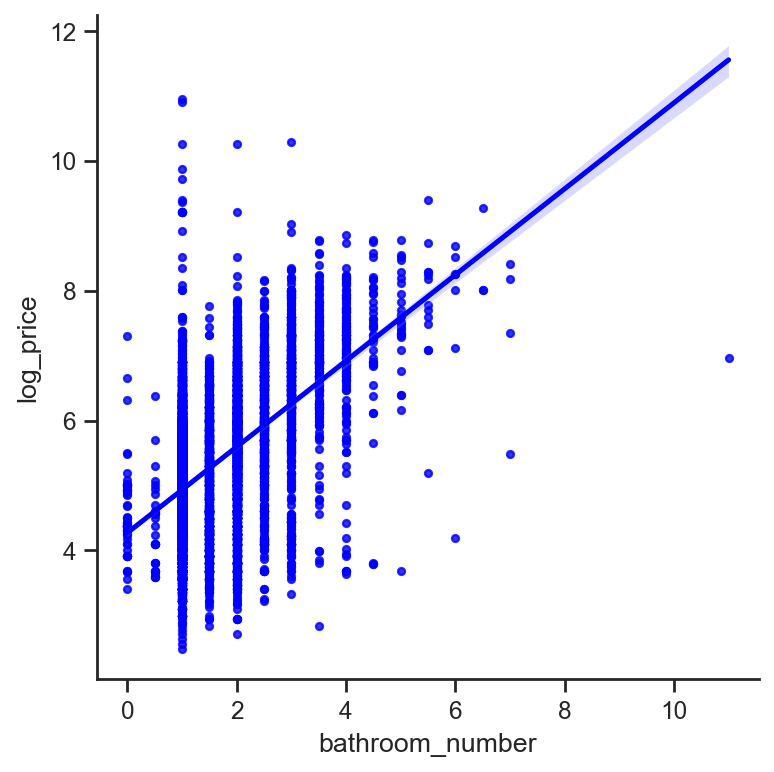

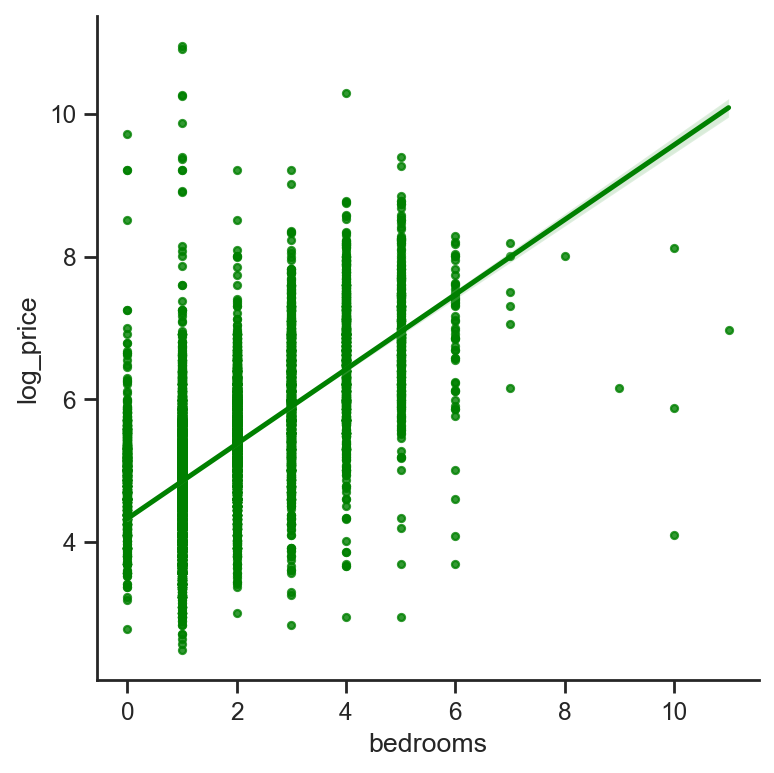

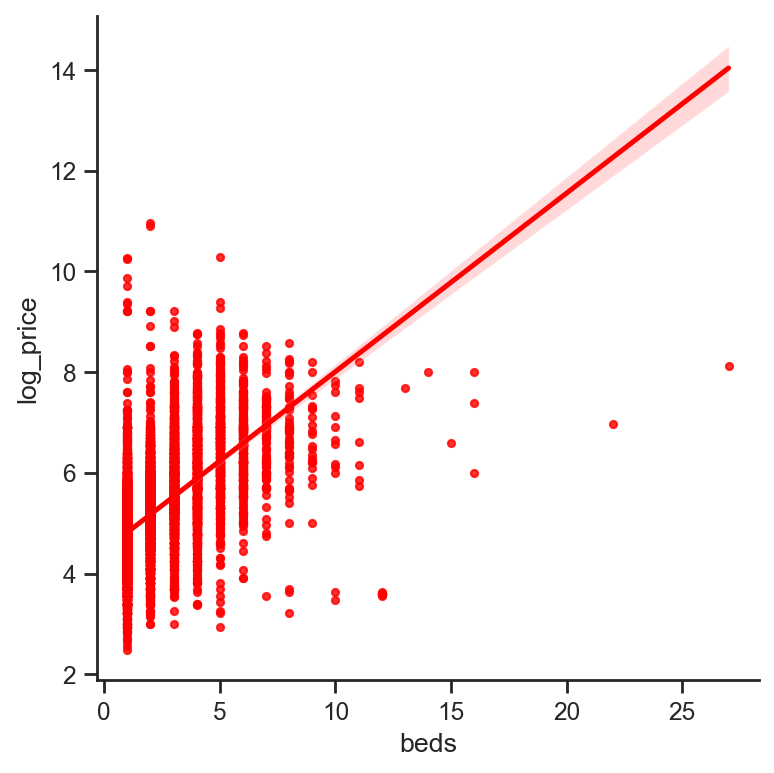

In [97]:
from itertools import cycle
scatter_size = 10

color_palette = cycle(['blue', 'green', 'red', 'orange', 'purple', 'brown', 'pink', 'gray', 'cyan', 'magenta', 'yellow', 'teal', 'lime', 'indigo', 'olive', 'navy', 'violet'])

# Iterate over each variable in the discrete_columns list and create a scatter plot with regression line
for var in discrete_columns:
    color = next(color_palette)
    sns.lmplot(x=var, y='log_price', data=train_data, scatter_kws={"s": scatter_size, "color": color}, line_kws={"color": color})

plt.show()

### Remove Outlieres

In [98]:
#remove outlieres via the figure above
print(train.shape)
train = train[-(train['bathroom_number'] > 7) | (train['bedrooms'] > 7) | (train['beds'] > 12)
|(train['reviews_per_month'] > 15)|(train['minimum_nights_avg_ntm'] > 700)]
print(train.shape)

(14144, 59)
(14144, 59)


### Correlation & Dependence

#### Prescreening

In [99]:
correlation = train.corr()['log_price']
correlation

neighborhood_overview                          -0.081808
host_since                                      0.033627
host_location                                   0.096641
host_response_rate                              0.039147
host_acceptance_rate                           -0.200558
host_is_superhost                               0.113264
host_listings_count                             0.119572
host_total_listings_count                       0.130234
host_verifications                              0.106297
host_identity_verified                          0.149645
latitude                                        0.254486
longitude                                       0.293877
accommodates                                    0.687373
bathroom_number                                 0.515091
bathroom_type                                  -0.512465
bedrooms                                        0.638083
beds                                            0.577668
price                          

In [100]:
correlation_threshold = 0.2
selected_columns = correlation[(correlation > correlation_threshold) | (correlation < -correlation_threshold)].index
train_selected = train[selected_columns]

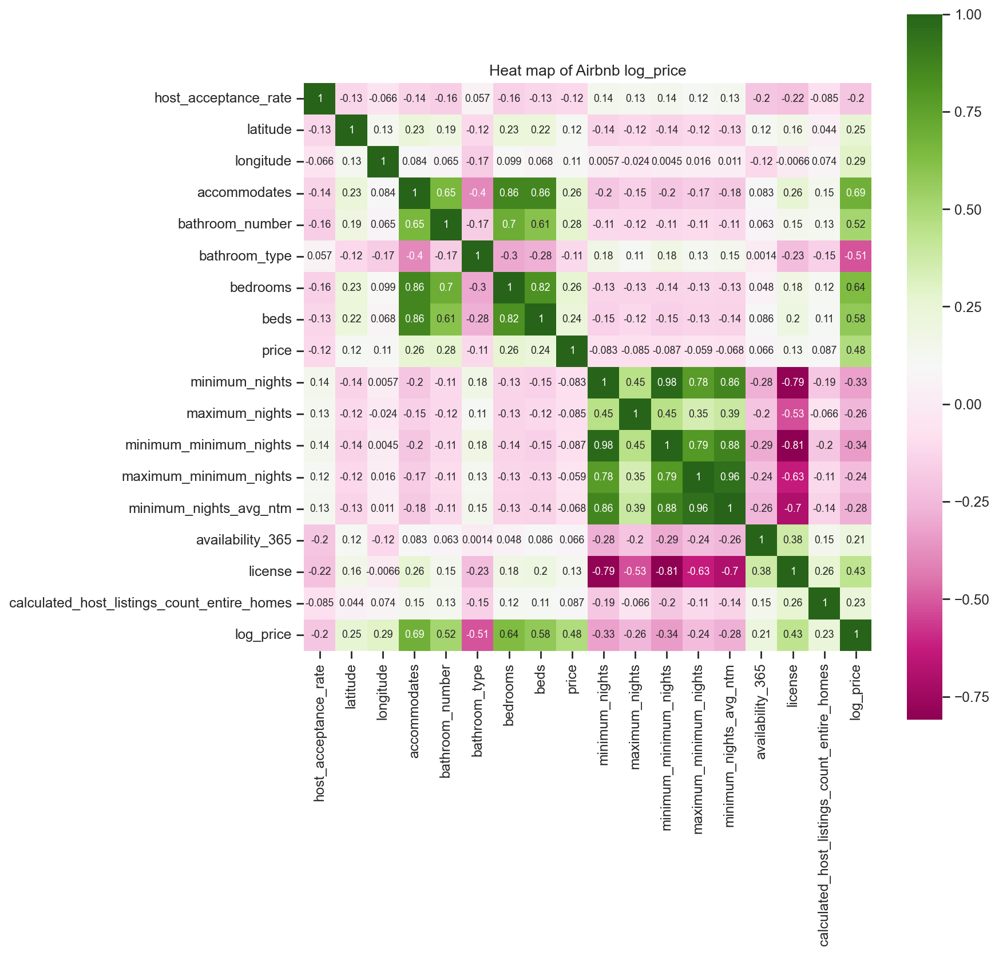

In [101]:
fig, ax = plt.subplots(figsize=(10, 10))
heatmap = sns.heatmap(train_selected.corr(), square=True, annot=True, cmap='PiYG', annot_kws={'fontsize': 8}, ax=ax)
heatmap.set_title('Heat map of Airbnb log_price')
ax.set_xlim(0, len(train_selected.columns))
ax.set_ylim(len(train_selected.columns), 0)
plt.show()

## Interaction effects

##### Interaction features

In [102]:
train_1 = train.drop('log_price', axis=1)

In [103]:
#For bedrooms and 
train['bed_bedroom_total'] = train['beds'] * train['bedrooms']
train['accommodates_bedrooms'] = train['accommodates'] * train['bedrooms']
train['bathroom_number_bedrooms'] = train['bedrooms'] * train['bathroom_number']
train['bathroom_number_beds'] = train['beds'] * train['bathroom_number']

In [104]:
correlation = train.corr()['log_price']
correlation

neighborhood_overview                          -0.081808
host_since                                      0.033627
host_location                                   0.096641
host_response_rate                              0.039147
host_acceptance_rate                           -0.200558
host_is_superhost                               0.113264
host_listings_count                             0.119572
host_total_listings_count                       0.130234
host_verifications                              0.106297
host_identity_verified                          0.149645
latitude                                        0.254486
longitude                                       0.293877
accommodates                                    0.687373
bathroom_number                                 0.515091
bathroom_type                                  -0.512465
bedrooms                                        0.638083
beds                                            0.577668
price                          

## Feature Engineering

In [105]:
features_to_check = numeral_data.columns.tolist()

# Create a correlation matrix for the features
correlation_matrix = train[features_to_check].corr().abs()

# Create an empty list to store the multicollinear features
multicollinear_features = []

# Loop through each pair of features and check their correlation
for i in range(len(features_to_check)):
    for j in range(i+1, len(features_to_check)):
        feature1 = features_to_check[i]
        feature2 = features_to_check[j]
        
        # Check if the correlation between the features is above the threshold (e.g., 0.7)
        if correlation_matrix.loc[feature1, feature2] >= 0.7:
            multicollinear_features.append((feature1, feature2, correlation_matrix.loc[feature1, feature2]))

# Print the multicollinear features and their correlation values
print("Multicollinear Features:")
for feature1, feature2, correlation in multicollinear_features:
    print(f"{feature1} - {feature2}: {correlation}")

Multicollinear Features:
host_listings_count - host_total_listings_count: 0.9829110670832573
bedrooms - beds: 0.8172154352878643
review_scores_rating - review_scores_accuracy: 0.9271466330815044
review_scores_rating - review_scores_cleanliness: 0.9083948970156549
review_scores_rating - review_scores_checkin: 0.8488378278281412
review_scores_rating - review_scores_communication: 0.8753770585129301
review_scores_rating - review_scores_location: 0.7792655683198069
review_scores_rating - review_scores_value: 0.9221028898184249
review_scores_accuracy - review_scores_cleanliness: 0.8772712172553477
review_scores_accuracy - review_scores_checkin: 0.851432866606035
review_scores_accuracy - review_scores_communication: 0.875020111319669
review_scores_accuracy - review_scores_location: 0.7883207446648292
review_scores_accuracy - review_scores_value: 0.9064091554239034
review_scores_cleanliness - review_scores_checkin: 0.784592541402336
review_scores_cleanliness - review_scores_communication: 0.8

In [106]:
from sklearn.linear_model import Lasso
from sklearn.decomposition import PCA

# Select the subset of features with multicollinearity
selected_features = ['accommodates', 'bedrooms', 'beds', 'bed_bedroom_total', 'accommodates_bedrooms',
                     'bathroom_number_bedrooms', 'bathroom_number_beds']

# Approach 1: Feature Selection using Lasso Regression
lasso = Lasso(alpha=0.1)  # Adjust the regularization parameter alpha as needed
lasso.fit(train[selected_features], train['log_price'])
selected_features_lasso = [f for f, coef in zip(selected_features, lasso.coef_) if abs(coef) > 0]
print("Selected features after Lasso Regression:", selected_features_lasso)

# Approach 2: Feature Extraction using PCA
pca = PCA(n_components=3)  # Adjust the number of components as needed
pca_features = pca.fit_transform(train[selected_features])
print("PCA Features shape:", pca_features.shape)

# Approach 3: Combine Features
train['bed_bedroom_diff'] = train['beds'] - train['bedrooms']
train['bed_bedroom_ratio'] = train['beds'] / train['bedrooms']

# Approach 4: Regularization using Ridge Regression
from sklearn.linear_model import Ridge
ridge = Ridge(alpha=0.1)  # Adjust the regularization parameter alpha as needed
ridge.fit(train[selected_features], train['log_price'])
print("Ridge Regression Coefficients:", ridge.coef_)


Selected features after Lasso Regression: ['accommodates', 'bathroom_number_bedrooms']
PCA Features shape: (14144, 3)
Ridge Regression Coefficients: [ 0.37161793  0.04852932 -0.02006943  0.03107479 -0.05771133  0.14708902
 -0.06490653]


### Map

In [107]:
# !yes | conda install -c conda-forge proj

In [108]:

# !yes | conda install -c conda-forge geos


In [109]:
# !yes | conda install -c conda-forge gdal


In [110]:
#!yes | conda install -c conda-forge cartopy

# pip install cartopy

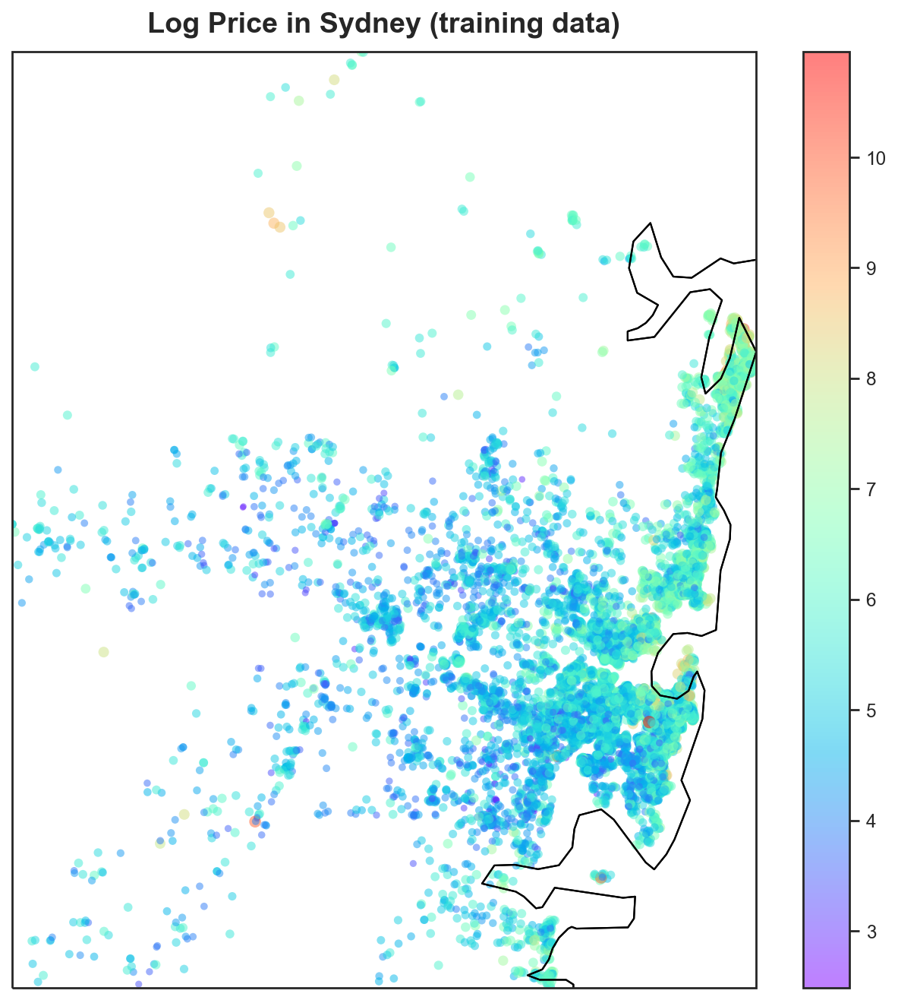

In [111]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
# Latitude and longitude for the edges of the map
lat1, lat2, lon1, lon2 = train['latitude'].max(), train['latitude'].min(), train['longitude'].min(), train['longitude'].max()

# Create figures
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection = ccrs.Mercator())

# Get latitude and longitude for each data point
x, y = (train['longitude'].to_numpy(), train['latitude'].to_numpy())

# Scatter plot as heat map
pos = ax.scatter(x, y, s=(train['log_price'].to_numpy()*5), c=train['log_price'].to_numpy(), 
           edgecolors='none', cmap=plt.get_cmap('rainbow'), alpha=0.5, transform=ccrs.PlateCarree())

# Add state borders and coast line
ax.add_feature(cfeature.STATES.with_scale('10m'))
ax.add_feature(cfeature.COASTLINE.with_scale('10m'))
ax.set_extent([150.67462, 151.34041, -33.39267, -34.09202], crs=ccrs.PlateCarree())

# Add title
ax.set_title('Log Price in Sydney (training data)', fontsize=17, y=1.01, fontweight='bold')
plt.colorbar(pos)

plt.show()

In [112]:
def feature_linear(df): 
    dd = ['latitude','longitude','review_scores_accuracy',
            'review_scores_cleanliness', 'review_scores_checkin','review_scores_communication', 
            'review_scores_location','review_scores_value','property_type','host_neighbourhood']
    df=df.drop(columns = dd)
    
    frequent_words1 = ['space', 'Sydney', 'apartment', 'enjoy', 'Guest', 'home', 'perfect', 'balcony',
                       'bathroom', 'beach', 'close', 'things']  # List of frequent words
    fil_description1 = df['description'].str.contains('|'.join(frequent_words1), case=False) 
    df['description'] = fil_description1
    df['description'] = df['description'].astype(int)                # Transform boolean to integer

    frequent_words2 = ['Long term', 'Smoke alarm', 'stays allowed', 'Hot water', 'Cooking basics', 'Bed linens',
                       'Hair dryer', 'Wifi Essentials', 'Free parking', 'allowed Kitchen', 'Air conditioning','dryer',
                       'Fire extinguisher','stays','allowed','coffee maker']  # List of frequent words
    fil_description2 = df['amenities'].str.contains('|'.join(frequent_words2), case=False) 
    df['amenities'] = fil_description2 
    df['amenities'] = df['amenities'].astype(int)                # Transform boolean to integer
    
    frequent_words3 = ['Sydney','love','home','guest','enjoy','Australia','properties','travelling','life','happy',
                       'hope','work','apartment','best','friend','time','short term']  # List of frequent words
    fil_description3 = df['host_about'].str.contains('|'.join(frequent_words3), case=False) 
    df['host_about'] = fil_description3
    df['host_about'] = df['host_about'].astype(int)                # Transform boolean to integer

    
    df['host_location*superhost'] = df['host_location']*df['host_is_superhost']
    df['host_identity*instant'] = df['host_identity_verified']*df['instant_bookable']
    df['host_location*instant'] = df['host_location']*df['instant_bookable']
        
    labels = ['host_verifications','room_type','neighbourhood_cleansed','host_response_time']  
    
    for label in labels:

        features = pd.get_dummies(df[label], prefix=label, drop_first=True)
        df = df.join(features)
    df = df.drop(columns = labels)
    
    
    df['source']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source
#     df['neighborhood_overview']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source

    return df
    
train_linear = feature_linear(train_data)
valid_linear = feature_linear(val_data)
test_linear = feature_linear(test_data)

In [113]:
def feature_tree(df): 
    dd = ['latitude','longitude','review_scores_accuracy',
            'review_scores_cleanliness', 'review_scores_checkin','review_scores_communication', 
            'review_scores_location','review_scores_value','property_type','host_neighbourhood']
    df=df.drop(columns = dd)
    
    frequent_words1 = ['space', 'Sydney', 'apartment', 'enjoy', 'Guest', 'home', 'perfect', 'balcony',
                       'bathroom', 'beach', 'close', 'things']  # List of frequent words
    fil_description1 = df['description'].str.contains('|'.join(frequent_words1), case=False) 
    df['description'] = fil_description1
#     df['description'] = df['description'].astype(int)                # Transform boolean to integer

    frequent_words2 = ['Long term', 'Smoke alarm', 'stays allowed', 'Hot water', 'Cooking basics', 'Bed linens',
                       'Hair dryer', 'Wifi Essentials', 'Free parking', 'allowed Kitchen', 'Air conditioning','dryer',
                       'Fire extinguisher','stays','allowed','coffee maker']  # List of frequent words
    fil_description2 = df['amenities'].str.contains('|'.join(frequent_words2), case=False) 
    df['amenities'] = fil_description2 
#     df['amenities'] = df['amenities'].astype(int)                # Transform boolean to integer
    
    frequent_words3 = ['Sydney','love','home','guest','enjoy','Australia','properties','travelling','life','happy',
                       'hope','work','apartment','best','friend','time','short term']  # List of frequent words
    fil_description3 = df['host_about'].str.contains('|'.join(frequent_words3), case=False) 
    df['host_about'] = fil_description3
#     df['host_about'] = df['host_about'].astype(int)                # Transform boolean to integer

    
    df['host_location*superhost'] = df['host_location']*df['host_is_superhost']
    df['host_identity*instant'] = df['host_identity_verified']*df['instant_bookable']
    df['host_location*instant'] = df['host_location']*df['instant_bookable']
        
    labels = ['host_verifications','room_type','neighbourhood_cleansed','host_response_time']  
    
    for label in labels:

         features = pd.get_dummies(df[label], prefix=label)
         df = df.join(features)
    df = df.drop(columns = labels)
    
    df['source']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source
#      df['neighborhood_overview']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source

    return df
    
train_tree = feature_tree(train_data)
valid_tree = feature_tree(val_data)
test_tree = feature_tree(test_data)

In [114]:
def feature_lasso(df): 
    dd = ['latitude','longitude','review_scores_accuracy',
            'review_scores_cleanliness', 'review_scores_checkin','review_scores_communication', 
            'review_scores_location','review_scores_value','property_type','host_neighbourhood']
    df=df.drop(columns = dd)
    
    frequent_words1 = ['space', 'Sydney', 'apartment', 'enjoy', 'Guest', 'home', 'perfect', 'balcony',
                       'bathroom', 'beach', 'close', 'things']  # List of frequent words
    fil_description1 = df['description'].str.contains('|'.join(frequent_words1), case=False) 
    df['description'] = fil_description1
    df['description'] = df['description'].astype(int)                # Transform boolean to integer

    frequent_words2 = ['Long term', 'Smoke alarm', 'stays allowed', 'Hot water', 'Cooking basics', 'Bed linens',
                       'Hair dryer', 'Wifi Essentials', 'Free parking', 'allowed Kitchen', 'Air conditioning','dryer',
                       'Fire extinguisher','stays','allowed','coffee maker']  # List of frequent words
    fil_description2 = df['amenities'].str.contains('|'.join(frequent_words2), case=False) 
    df['amenities'] = fil_description2 
    df['amenities'] = df['amenities'].astype(int)                # Transform boolean to integer
    
    frequent_words3 = ['Sydney','love','home','guest','enjoy','Australia','properties','travelling','life','happy',
                       'hope','work','apartment','best','friend','time','short term']  # List of frequent words
    fil_description3 = df['host_about'].str.contains('|'.join(frequent_words3), case=False) 
    df['host_about'] = fil_description3
    df['host_about'] = df['host_about'].astype(int)                # Transform boolean to integer

    
    df['host_location*superhost'] = df['host_location']*df['host_is_superhost']
    df['host_identity*instant'] = df['host_identity_verified']*df['instant_bookable']
    df['host_location*instant'] = df['host_location']*df['instant_bookable']
        
    labels = ['host_verifications','room_type','neighbourhood_cleansed','host_response_time']  
    
    for label in labels:

        features = pd.get_dummies(df[label], prefix=label, drop_first=False)
        df = df.join(features)
    df = df.drop(columns = labels)
    
    
    df['source']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source
#     df['neighborhood_overview']=(df['source'] =='previous scrape').astype(int) # creates dummy variable for source

    return df
    
train_lasso = feature_lasso(train_data)
valid_lasso = feature_lasso(val_data)
test_lasso = feature_lasso(test_data)

In [115]:
print(train_linear.shape)
print(valid_linear.shape)
print(test_linear.shape)

(14144, 95)
(3536, 95)
(4420, 95)


In [116]:
print(train_lasso.shape)
print(valid_lasso.shape)
print(test_lasso.shape)

(14144, 99)
(3536, 99)
(4420, 99)


In [117]:
print(train_tree.shape)
print(valid_tree.shape)
print(test_tree.shape)

(14144, 99)
(3536, 99)
(4420, 99)


In [118]:
is_same_train = (train_lasso == train_tree).all().all()

print(is_same_train)

True


In [119]:
is_same_valid = (valid_lasso == valid_tree).all().all()
print(is_same_valid)

True


In [120]:
is_same_test = (test_lasso == test_tree).all().all()
print(is_same_test)

True


In [121]:
# For the model part, please see another file (ahhh). 
# In order to facilitate the subsequent import, the processed data sets are saved separately.

# For linear regression
train_linear.to_csv('train_linear.csv',index = False)
valid_linear.to_csv('valid_linear.csv',index = False)
test_linear.to_csv('test_linear.csv',index = False)

# For Lasso 
train_lasso.to_csv('train_lasso.csv',index = False)
valid_lasso.to_csv('valid_lasso.csv',index = False)
test_lasso.to_csv('test_lasso.csv',index = False)

# For Tree
train_tree.to_csv('train_tree.csv',index = False)
valid_tree.to_csv('valid_tree.csv',index = False)
test_tree.to_csv('test_tree.csv',index = False)